**<center><h1>Advanced Computer Vision for Artificial Intelligence Assignment</h1></center>**
**<center><h2>Part 1 - Object Classification Component</h2></center>**
**<center><h3>Matthias Bartolo, Jerome Agius, Isaac Muscat</h3></center>**

**<h3>Packages</h3>**

Note that the notebook was run in python version 3.9.16, in the case that `tensorflow.keras` is not available, try `tensorflow.python.keras` instead.

In [1]:
import os
import cv2
from matplotlib import pyplot as plt
import matplotlib.patches as patches
from PIL import Image, ImageDraw, ImageFont
import numpy as np
import pandas as pd
import seaborn as sn
import json

In [2]:
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2
from tensorflow.keras.applications.efficientnet_v2 import EfficientNetV2B3
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions

**<h3>Loading Images</h3>**

**<h4>Function which loads images from the given path</h4>**

In [3]:
def load_imgs(path, no_of_images, img_size=(224,224), do_display=False):
    """Function which loads images from the given path

    Args:
        path (str): path to the folder with images.
        no_of_images (int): number of images to load.
        img_size (tuple, optional): size of the image. Defaults to (224,224).
        do_display (bool): flag to display images. Defaults to False.

    Returns:
        images (dict): dictionary with images
        image_paths (list): list of image paths
    """
    # Declaring necessary variables
    images = {}
    image_paths = []

    # Iterating through all images in the given path
    for img_no, img_name in enumerate(os.listdir(path)):
        # Breaking from loop if no_of_images is reached
        if img_no == no_of_images:
            break

        # Loading, resizing and storing images in a dictionary
        image_paths.append(os.path.join(path, img_name))
        img = Image.open(os.path.join(path, img_name))
        img = img.resize(img_size)
        images[img_no] = img

        # Displaying images if do_display is True
        if do_display:
            print('\033[1m' + 'Image {}  Image name: {}'.format(img_no+1, img_name) + '\033[0m')
            display(img)
    
    # Returning images and image paths
    return images, image_paths

In [4]:
# Specifying path to the images
image_path = '../pizza_classification/train/pizza'
no_of_images = 20 #None
do_display = False

# Loading images
pizza_images, pizza_image_paths = load_imgs(path=image_path, no_of_images=no_of_images, do_display=do_display)
no_of_pizza_images = len(pizza_images)

In [5]:
# Specifying path to the images
image_path = '../pizza_classification/train/not_pizza'
no_of_images = 20 #None
do_display = False

# Loading images
not_pizza_images, not_pizza_image_paths = load_imgs(path=image_path, no_of_images=no_of_images, do_display=do_display)
no_of_not_pizza_images = len(not_pizza_images)

**<h3>Loading Pretrained Weights</h3>**

In [6]:
# Retrieving the relvant models using the imagenet pretained weights
modelRN50 = ResNet50(weights='imagenet')
modelV16 = VGG16(weights='imagenet')
modelMN = MobileNet(weights='imagenet')
modelIRN = InceptionResNetV2(weights='imagenet')
modelENV2 = EfficientNetV2B3(weights='imagenet')

**<h4>ResNet50 Model</h4>**

In [7]:
modelRN50.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

**<h4>VGG16 Model</h4>**

In [8]:
modelV16.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

**<h4>MobileNet Model</h4>**

In [9]:
modelMN.summary()

Model: "mobilenet_1.00_224"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 112, 112, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 112, 112, 32)     128       
 ation)                                         

**<h4>Inception ResNet V2 Model</h4>**

In [10]:
modelIRN.summary()

Model: "inception_resnet_v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 149, 149, 32  864         ['input_4[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 149, 149, 32  96         ['conv2d[0][0]']                 
 alization)                     )                                               

**<h4>EfficientNet V2 Model</h4>**

In [11]:
modelENV2.summary()

Model: "efficientnetv2-b3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 300, 300, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 300, 300, 3)  0           ['input_5[0][0]']                
                                                                                                  
 normalization (Normalization)  (None, 300, 300, 3)  0           ['rescaling[0][0]']              
                                                                                                  
 stem_conv (Conv2D)             (None, 150, 150, 40  1080        ['normalization[0

**<h3>Making Predictions</h3>**

**<h4>Function which generates predictions for the given images using the given model</h4>**

In [12]:
def make_predictions(model, image_paths, images, top_predictions=5, target_size=(224,224), do_display=False):
    """Function which generates predictions for the given images using the given model

    Args:
        model (keras model): model to make predictions.
        image_paths (list): list of image paths.
        images (dict): dictionary with images.
        top_predictions (int): number of top predictions to return.
        target_size (tuple): size of the image to be used in the model. Defaults to (224,224).
        do_display (bool): flag to display images. Defaults to False.

    Returns:
        predictions (list): list of predictions
    """
    # Declaring necessary variables
    predictions = []

    # Iterating through all images in the given dictionary
    for img_name, img in images.items():
        # Resizing image
        img = img.resize(target_size)
        
        # Converting to RGB
        img = img.convert("RGB")

        # Preprocessing image
        img = image.img_to_array(img)
        img = np.expand_dims(img, axis=0)
        img = preprocess_input(img)

        # Making predictions
        preds = model.predict(img)
        predictions.append(decode_predictions(preds, top=top_predictions)[0])

        # Displaying the predictions if do_display is True
        if do_display:
            print('Image name: {} Predictions: {}' \
                  .format(image_paths[img_name].split('/')[-1], decode_predictions(preds, top=top_predictions)[0]))

    # Returning predictions
    return predictions

In [13]:
resultRN50 = make_predictions(modelRN50, pizza_image_paths, pizza_images, 5, do_display=True)
resultRN50 += make_predictions(modelRN50, not_pizza_image_paths, not_pizza_images, 5, do_display=True)

1/1 [==============================] - 2s 2s/step
Image name: pizza\1001116.jpg Predictions: [('n07873807', 'pizza', 0.9999999), ('n07875152', 'potpie', 6.747987e-08), ('n07693725', 'bagel', 4.4073776e-08), ('n03400231', 'frying_pan', 1.360382e-08), ('n04447861', 'toilet_seat', 8.093102e-09)]
1/1 [==============================] - 0s 13ms/step
Image name: pizza\1008104.jpg Predictions: [('n07873807', 'pizza', 0.99861157), ('n07875152', 'potpie', 0.0007160981), ('n03400231', 'frying_pan', 0.00013635727), ('n07693725', 'bagel', 0.0001271575), ('n07613480', 'trifle', 0.00010258664)]
1/1 [==============================] - 0s 14ms/step
Image name: pizza\1008144.jpg Predictions: [('n07831146', 'carbonara', 0.8518592), ('n07875152', 'potpie', 0.055149674), ('n07684084', 'French_loaf', 0.03270587), ('n07860988', 'dough', 0.011584136), ('n04081281', 'restaurant', 0.010939247)]
1/1 [==============================] - 0s 13ms/step
Image name: pizza\1008844.jpg Predictions: [('n07873807', 'pizza', 

In [14]:
resultV16 = make_predictions(modelV16, pizza_image_paths, pizza_images, 5, do_display=True)
resultV16 += make_predictions(modelV16, not_pizza_image_paths, not_pizza_images, 5, do_display=True)

1/1 [==============================] - 1s 550ms/step
Image name: pizza\1001116.jpg Predictions: [('n07873807', 'pizza', 0.99994636), ('n07684084', 'French_loaf', 1.1503763e-05), ('n02776631', 'bakery', 6.451149e-06), ('n03400231', 'frying_pan', 5.8460637e-06), ('n04270147', 'spatula', 5.209255e-06)]
1/1 [==============================] - 0s 12ms/step
Image name: pizza\1008104.jpg Predictions: [('n07873807', 'pizza', 0.9291934), ('n07693725', 'bagel', 0.015291826), ('n03400231', 'frying_pan', 0.0059393267), ('n07875152', 'potpie', 0.005593637), ('n07684084', 'French_loaf', 0.004487564)]
1/1 [==============================] - 0s 11ms/step
Image name: pizza\1008144.jpg Predictions: [('n07693725', 'bagel', 0.25314876), ('n07684084', 'French_loaf', 0.22963122), ('n07831146', 'carbonara', 0.14907119), ('n07873807', 'pizza', 0.08431909), ('n07697313', 'cheeseburger', 0.052288994)]
1/1 [==============================] - 0s 11ms/step
Image name: pizza\1008844.jpg Predictions: [('n07873807', 'pi

In [15]:
resultMN = make_predictions(modelMN, pizza_image_paths, pizza_images, 5, do_display=True)
resultMN += make_predictions(modelMN, not_pizza_image_paths, not_pizza_images, 5, do_display=True)

1/1 [==============================] - 0s 181ms/step
Image name: pizza\1001116.jpg Predictions: [('n04325704', 'stole', 0.68156), ('n03980874', 'poncho', 0.11990193), ('n02869837', 'bonnet', 0.0925213), ('n02834397', 'bib', 0.05172734), ('n04026417', 'purse', 0.015802072)]
1/1 [==============================] - 0s 13ms/step
Image name: pizza\1008104.jpg Predictions: [('n04033995', 'quilt', 0.30523968), ('n02834397', 'bib', 0.0829311), ('n04209133', 'shower_cap', 0.05541818), ('n02808304', 'bath_towel', 0.025959007), ('n03642806', 'laptop', 0.024982348)]
1/1 [==============================] - 0s 12ms/step
Image name: pizza\1008144.jpg Predictions: [('n04325704', 'stole', 0.2261956), ('n04033995', 'quilt', 0.16963886), ('n09193705', 'alp', 0.09910928), ('n03980874', 'poncho', 0.09651398), ('n03485794', 'handkerchief', 0.049215235)]
1/1 [==============================] - 0s 12ms/step
Image name: pizza\1008844.jpg Predictions: [('n04118538', 'rugby_ball', 0.20199367), ('n03598930', 'jigsaw

In [16]:
resultIRN = make_predictions(modelIRN, pizza_image_paths, pizza_images, 5, do_display=True, target_size=(299,299))
resultIRN += make_predictions(modelIRN, not_pizza_image_paths, not_pizza_images, 5, do_display=True, target_size=(299,299))

1/1 [==============================] - 1s 1s/step
Image name: pizza\1001116.jpg Predictions: [('n06596364', 'comic_book', 1.0), ('n02791124', 'barber_chair', 1.0538759e-23), ('n04517823', 'vacuum', 9.966662e-34), ('n03794056', 'mousetrap', 1.7626234e-37), ('n02321529', 'sea_cucumber', 0.0)]
1/1 [==============================] - 0s 22ms/step
Image name: pizza\1008104.jpg Predictions: [('n06596364', 'comic_book', 1.0), ('n02791124', 'barber_chair', 4.5798334e-17), ('n04517823', 'vacuum', 2.2321156e-19), ('n03794056', 'mousetrap', 2.1728937e-27), ('n03995372', 'power_drill', 3.8601745e-29)]
1/1 [==============================] - 0s 22ms/step
Image name: pizza\1008144.jpg Predictions: [('n06596364', 'comic_book', 1.0), ('n15075141', 'toilet_tissue', 0.0), ('n02319095', 'sea_urchin', 0.0), ('n02391049', 'zebra', 0.0), ('n02389026', 'sorrel', 0.0)]
1/1 [==============================] - 0s 23ms/step
Image name: pizza\1008844.jpg Predictions: [('n06596364', 'comic_book', 1.0), ('n04517823', 

In [17]:
resultENV2 = make_predictions(modelENV2, pizza_image_paths, pizza_images, 5, do_display=True, target_size=(300,300))
resultENV2 += make_predictions(modelENV2, not_pizza_image_paths, not_pizza_images, 5, do_display=True, target_size=(300,300))

1/1 [==============================] - 1s 1s/step
Image name: pizza\1001116.jpg Predictions: [('n01496331', 'electric_ray', 0.40512678), ('n04209133', 'shower_cap', 0.19029905), ('n04447861', 'toilet_seat', 0.057381734), ('n03775071', 'mitten', 0.020587029), ('n02869837', 'bonnet', 0.01998999)]
1/1 [==============================] - 0s 18ms/step
Image name: pizza\1008104.jpg Predictions: [('n04447861', 'toilet_seat', 0.49915838), ('n07873807', 'pizza', 0.22457382), ('n04542943', 'waffle_iron', 0.048930723), ('n07875152', 'potpie', 0.02665085), ('n07613480', 'trifle', 0.020376053)]
1/1 [==============================] - 0s 17ms/step
Image name: pizza\1008144.jpg Predictions: [('n07860988', 'dough', 0.45411813), ('n07875152', 'potpie', 0.043943502), ('n04525038', 'velvet', 0.018564789), ('n07684084', 'French_loaf', 0.014236123), ('n01665541', 'leatherback_turtle', 0.009946653)]
1/1 [==============================] - 0s 17ms/step
Image name: pizza\1008844.jpg Predictions: [('n03920288', '

**<h3>Printing Results</h3>**

**<h4>Function which prints classification results</h4>**

In [18]:
def print_classification_results(images, image_paths, results, do_save=False, save_path=None):
    """Function which prints classification results

    Args:
        images (dict): dictionary with images.
        image_paths (list): list of image paths.
        results (list): list of predictions.
        do_save (bool): flag to save results. Defaults to False.
        save_path (str): path to save results. Defaults to None.
    """
    # Declaring necessary variables
    results_dict = {}

    # Iterating through all images in the given dictionary
    for img_name, img in images.items():
        # Displaying image
        print('\033[1m' + 'Image name: {}'.format(image_paths[img_name].split('/')[-1]) + '\033[0m')
        display(img)

        # Adding image name to the dictionary
        results_dict[image_paths[img_name].split('/')[-1]] = {}

        # Displaying predictions
        for result in results[img_name]:
            # Printing results
            print('\033[1m' + 'Model: {}  Predictions: {} Confidence: {:.2%}' \
                  .format(result[0], result[1], result[2]) + '\033[0m')
            
            # Saving results to a dictionary
            results_dict[image_paths[img_name].split('/')[-1]][result[0]] = {'prediction': result[1], 'confidence': str(result[2])}
        print('\n')

    # Saving results if do_save is True to a json file
    if do_save:
        # Creating path if it does not exist
        if not os.path.exists(save_path):
            os.makedirs(save_path)

        # Saving model predictions to a json file
        with open(os.path.join(save_path, 'predictions.json'), 'w') as f:
            json.dump(results_dict, f, indent=4)
    

Image name: pizza\1001116.jpg


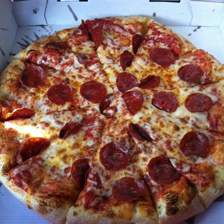

Model: n07873807  Predictions: pizza Confidence: 100.00%
Model: n07875152  Predictions: potpie Confidence: 0.00%
Model: n07693725  Predictions: bagel Confidence: 0.00%
Model: n03400231  Predictions: frying_pan Confidence: 0.00%
Model: n04447861  Predictions: toilet_seat Confidence: 0.00%


Image name: pizza\1008104.jpg


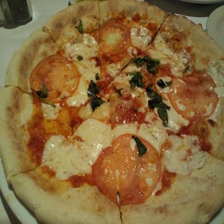

Model: n07873807  Predictions: pizza Confidence: 99.86%
Model: n07875152  Predictions: potpie Confidence: 0.07%
Model: n03400231  Predictions: frying_pan Confidence: 0.01%
Model: n07693725  Predictions: bagel Confidence: 0.01%
Model: n07613480  Predictions: trifle Confidence: 0.01%


Image name: pizza\1008144.jpg


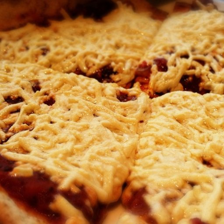

Model: n07831146  Predictions: carbonara Confidence: 85.19%
Model: n07875152  Predictions: potpie Confidence: 5.51%
Model: n07684084  Predictions: French_loaf Confidence: 3.27%
Model: n07860988  Predictions: dough Confidence: 1.16%
Model: n04081281  Predictions: restaurant Confidence: 1.09%


Image name: pizza\1008844.jpg


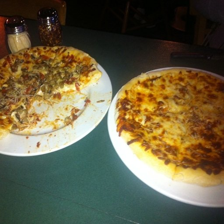

Model: n07873807  Predictions: pizza Confidence: 61.51%
Model: n07875152  Predictions: potpie Confidence: 23.60%
Model: n07579787  Predictions: plate Confidence: 7.80%
Model: n04081281  Predictions: restaurant Confidence: 1.71%
Model: n07831146  Predictions: carbonara Confidence: 1.00%


Image name: pizza\1008941.jpg


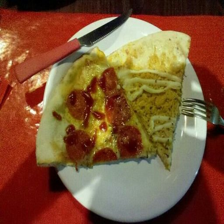

Model: n07880968  Predictions: burrito Confidence: 70.08%
Model: n07614500  Predictions: ice_cream Confidence: 14.53%
Model: n07579787  Predictions: plate Confidence: 2.82%
Model: n07697537  Predictions: hotdog Confidence: 1.91%
Model: n07697313  Predictions: cheeseburger Confidence: 1.83%


Image name: pizza\1011404.jpg


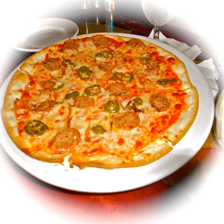

Model: n07873807  Predictions: pizza Confidence: 95.04%
Model: n04263257  Predictions: soup_bowl Confidence: 2.87%
Model: n03400231  Predictions: frying_pan Confidence: 0.84%
Model: n07584110  Predictions: consomme Confidence: 0.23%
Model: n07590611  Predictions: hot_pot Confidence: 0.16%


Image name: pizza\102037.jpg


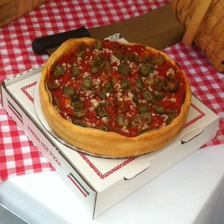

Model: n07697537  Predictions: hotdog Confidence: 94.44%
Model: n07873807  Predictions: pizza Confidence: 1.96%
Model: n07697313  Predictions: cheeseburger Confidence: 1.42%
Model: n04542943  Predictions: waffle_iron Confidence: 1.11%
Model: n07684084  Predictions: French_loaf Confidence: 0.52%


Image name: pizza\1026922.jpg


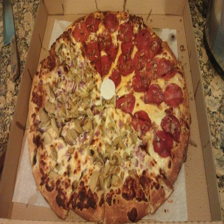

Model: n07873807  Predictions: pizza Confidence: 87.86%
Model: n04447861  Predictions: toilet_seat Confidence: 11.47%
Model: n07768694  Predictions: pomegranate Confidence: 0.32%
Model: n02927161  Predictions: butcher_shop Confidence: 0.04%
Model: n04192698  Predictions: shield Confidence: 0.03%


Image name: pizza\1029698.jpg


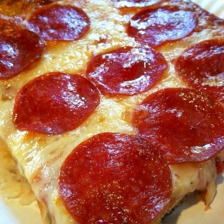

Model: n07873807  Predictions: pizza Confidence: 99.87%
Model: n07684084  Predictions: French_loaf Confidence: 0.03%
Model: n02776631  Predictions: bakery Confidence: 0.03%
Model: n07871810  Predictions: meat_loaf Confidence: 0.01%
Model: n03259280  Predictions: Dutch_oven Confidence: 0.01%


Image name: pizza\1032754.jpg


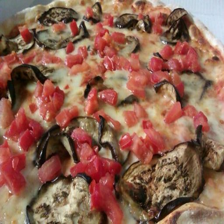

Model: n07873807  Predictions: pizza Confidence: 55.73%
Model: n07831146  Predictions: carbonara Confidence: 20.11%
Model: n07714571  Predictions: head_cabbage Confidence: 2.73%
Model: n07579787  Predictions: plate Confidence: 2.53%
Model: n07613480  Predictions: trifle Confidence: 2.28%


Image name: pizza\1033251.jpg


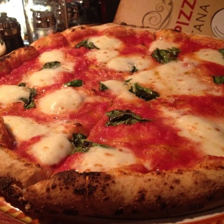

Model: n07873807  Predictions: pizza Confidence: 99.97%
Model: n03400231  Predictions: frying_pan Confidence: 0.01%
Model: n07613480  Predictions: trifle Confidence: 0.01%
Model: n07579787  Predictions: plate Confidence: 0.00%
Model: n07871810  Predictions: meat_loaf Confidence: 0.00%


Image name: pizza\1035854.jpg


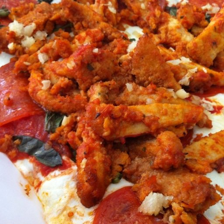

Model: n07873807  Predictions: pizza Confidence: 68.40%
Model: n01981276  Predictions: king_crab Confidence: 8.61%
Model: n07579787  Predictions: plate Confidence: 6.01%
Model: n07880968  Predictions: burrito Confidence: 4.96%
Model: n03400231  Predictions: frying_pan Confidence: 2.50%


Image name: pizza\103708.jpg


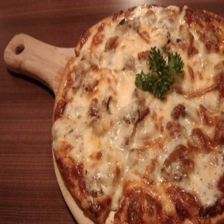

Model: n07873807  Predictions: pizza Confidence: 54.44%
Model: n07875152  Predictions: potpie Confidence: 13.64%
Model: n07860988  Predictions: dough Confidence: 5.05%
Model: n04542943  Predictions: waffle_iron Confidence: 3.44%
Model: n03400231  Predictions: frying_pan Confidence: 2.75%


Image name: pizza\1038357.jpg


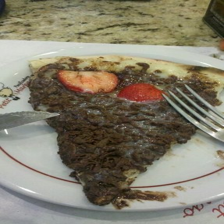

Model: n07579787  Predictions: plate Confidence: 81.89%
Model: n07871810  Predictions: meat_loaf Confidence: 7.44%
Model: n07836838  Predictions: chocolate_sauce Confidence: 5.17%
Model: n07613480  Predictions: trifle Confidence: 0.60%
Model: n07873807  Predictions: pizza Confidence: 0.55%


Image name: pizza\1040878.jpg


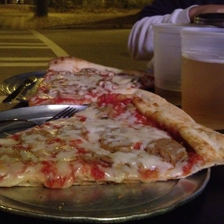

Model: n07873807  Predictions: pizza Confidence: 24.02%
Model: n07590611  Predictions: hot_pot Confidence: 18.40%
Model: n07613480  Predictions: trifle Confidence: 7.27%
Model: n04596742  Predictions: wok Confidence: 5.47%
Model: n01978287  Predictions: Dungeness_crab Confidence: 5.43%


Image name: pizza\1044524.jpg


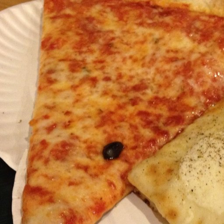

Model: n07873807  Predictions: pizza Confidence: 97.86%
Model: n07880968  Predictions: burrito Confidence: 1.02%
Model: n07684084  Predictions: French_loaf Confidence: 0.54%
Model: n07875152  Predictions: potpie Confidence: 0.37%
Model: n07579787  Predictions: plate Confidence: 0.07%


Image name: pizza\1044789.jpg


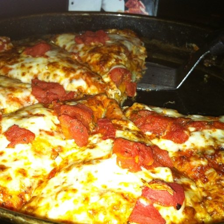

Model: n07873807  Predictions: pizza Confidence: 97.68%
Model: n03400231  Predictions: frying_pan Confidence: 1.32%
Model: n03259280  Predictions: Dutch_oven Confidence: 0.29%
Model: n02939185  Predictions: caldron Confidence: 0.23%
Model: n04111531  Predictions: rotisserie Confidence: 0.10%


Image name: pizza\1048649.jpg


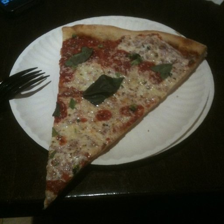

Model: n07873807  Predictions: pizza Confidence: 97.88%
Model: n07875152  Predictions: potpie Confidence: 1.63%
Model: n07579787  Predictions: plate Confidence: 0.16%
Model: n07880968  Predictions: burrito Confidence: 0.13%
Model: n03887697  Predictions: paper_towel Confidence: 0.06%


Image name: pizza\1054420.jpg


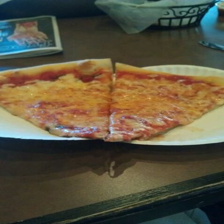

Model: n07873807  Predictions: pizza Confidence: 86.04%
Model: n04081281  Predictions: restaurant Confidence: 2.07%
Model: n07875152  Predictions: potpie Confidence: 2.04%
Model: n03400231  Predictions: frying_pan Confidence: 1.81%
Model: n04542943  Predictions: waffle_iron Confidence: 1.63%


Image name: pizza\1055065.jpg


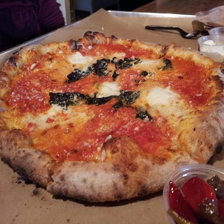

Model: n07873807  Predictions: pizza Confidence: 99.37%
Model: n07579787  Predictions: plate Confidence: 0.13%
Model: n03400231  Predictions: frying_pan Confidence: 0.10%
Model: n07684084  Predictions: French_loaf Confidence: 0.09%
Model: n07613480  Predictions: trifle Confidence: 0.05%


Image name: not_pizza\1005746.jpg


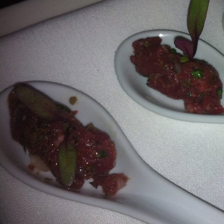

Model: n07873807  Predictions: pizza Confidence: 100.00%
Model: n07875152  Predictions: potpie Confidence: 0.00%
Model: n07693725  Predictions: bagel Confidence: 0.00%
Model: n03400231  Predictions: frying_pan Confidence: 0.00%
Model: n04447861  Predictions: toilet_seat Confidence: 0.00%


Image name: not_pizza\1009225.jpg


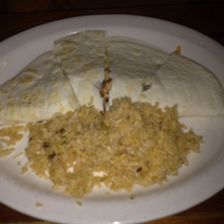

Model: n07873807  Predictions: pizza Confidence: 99.86%
Model: n07875152  Predictions: potpie Confidence: 0.07%
Model: n03400231  Predictions: frying_pan Confidence: 0.01%
Model: n07693725  Predictions: bagel Confidence: 0.01%
Model: n07613480  Predictions: trifle Confidence: 0.01%


Image name: not_pizza\1012312.jpg


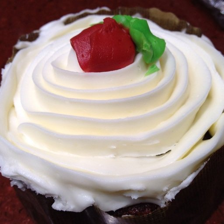

Model: n07831146  Predictions: carbonara Confidence: 85.19%
Model: n07875152  Predictions: potpie Confidence: 5.51%
Model: n07684084  Predictions: French_loaf Confidence: 3.27%
Model: n07860988  Predictions: dough Confidence: 1.16%
Model: n04081281  Predictions: restaurant Confidence: 1.09%


Image name: not_pizza\1018802.jpg


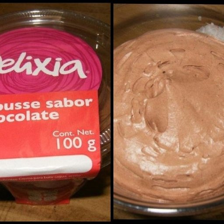

Model: n07873807  Predictions: pizza Confidence: 61.51%
Model: n07875152  Predictions: potpie Confidence: 23.60%
Model: n07579787  Predictions: plate Confidence: 7.80%
Model: n04081281  Predictions: restaurant Confidence: 1.71%
Model: n07831146  Predictions: carbonara Confidence: 1.00%


Image name: not_pizza\1020735.jpg


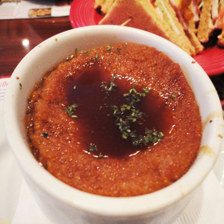

Model: n07880968  Predictions: burrito Confidence: 70.08%
Model: n07614500  Predictions: ice_cream Confidence: 14.53%
Model: n07579787  Predictions: plate Confidence: 2.82%
Model: n07697537  Predictions: hotdog Confidence: 1.91%
Model: n07697313  Predictions: cheeseburger Confidence: 1.83%


Image name: not_pizza\1027142.jpg


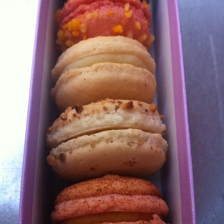

Model: n07873807  Predictions: pizza Confidence: 95.04%
Model: n04263257  Predictions: soup_bowl Confidence: 2.87%
Model: n03400231  Predictions: frying_pan Confidence: 0.84%
Model: n07584110  Predictions: consomme Confidence: 0.23%
Model: n07590611  Predictions: hot_pot Confidence: 0.16%


Image name: not_pizza\102839.jpg


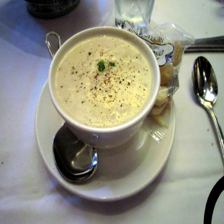

Model: n07697537  Predictions: hotdog Confidence: 94.44%
Model: n07873807  Predictions: pizza Confidence: 1.96%
Model: n07697313  Predictions: cheeseburger Confidence: 1.42%
Model: n04542943  Predictions: waffle_iron Confidence: 1.11%
Model: n07684084  Predictions: French_loaf Confidence: 0.52%


Image name: not_pizza\1043233.jpg


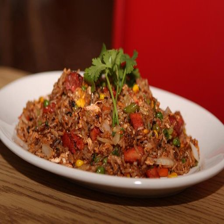

Model: n07873807  Predictions: pizza Confidence: 87.86%
Model: n04447861  Predictions: toilet_seat Confidence: 11.47%
Model: n07768694  Predictions: pomegranate Confidence: 0.32%
Model: n02927161  Predictions: butcher_shop Confidence: 0.04%
Model: n04192698  Predictions: shield Confidence: 0.03%


Image name: not_pizza\1045400.jpg


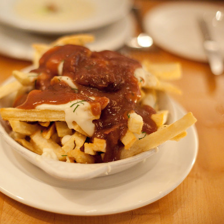

Model: n07873807  Predictions: pizza Confidence: 99.87%
Model: n07684084  Predictions: French_loaf Confidence: 0.03%
Model: n02776631  Predictions: bakery Confidence: 0.03%
Model: n07871810  Predictions: meat_loaf Confidence: 0.01%
Model: n03259280  Predictions: Dutch_oven Confidence: 0.01%


Image name: not_pizza\104773.jpg


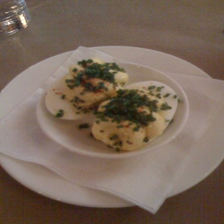

Model: n07873807  Predictions: pizza Confidence: 55.73%
Model: n07831146  Predictions: carbonara Confidence: 20.11%
Model: n07714571  Predictions: head_cabbage Confidence: 2.73%
Model: n07579787  Predictions: plate Confidence: 2.53%
Model: n07613480  Predictions: trifle Confidence: 2.28%


Image name: not_pizza\1050956.jpg


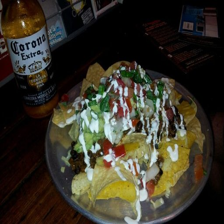

Model: n07873807  Predictions: pizza Confidence: 99.97%
Model: n03400231  Predictions: frying_pan Confidence: 0.01%
Model: n07613480  Predictions: trifle Confidence: 0.01%
Model: n07579787  Predictions: plate Confidence: 0.00%
Model: n07871810  Predictions: meat_loaf Confidence: 0.00%


Image name: not_pizza\1054362.jpg


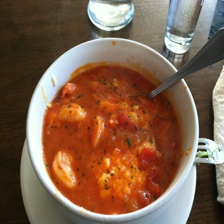

Model: n07873807  Predictions: pizza Confidence: 68.40%
Model: n01981276  Predictions: king_crab Confidence: 8.61%
Model: n07579787  Predictions: plate Confidence: 6.01%
Model: n07880968  Predictions: burrito Confidence: 4.96%
Model: n03400231  Predictions: frying_pan Confidence: 2.50%


Image name: not_pizza\1062097.jpg


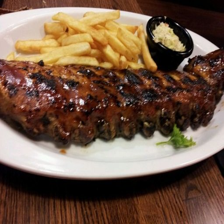

Model: n07873807  Predictions: pizza Confidence: 54.44%
Model: n07875152  Predictions: potpie Confidence: 13.64%
Model: n07860988  Predictions: dough Confidence: 5.05%
Model: n04542943  Predictions: waffle_iron Confidence: 3.44%
Model: n03400231  Predictions: frying_pan Confidence: 2.75%


Image name: not_pizza\1066151.jpg


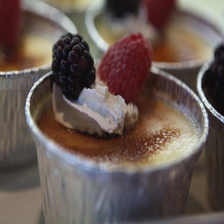

Model: n07579787  Predictions: plate Confidence: 81.89%
Model: n07871810  Predictions: meat_loaf Confidence: 7.44%
Model: n07836838  Predictions: chocolate_sauce Confidence: 5.17%
Model: n07613480  Predictions: trifle Confidence: 0.60%
Model: n07873807  Predictions: pizza Confidence: 0.55%


Image name: not_pizza\1070772.jpg


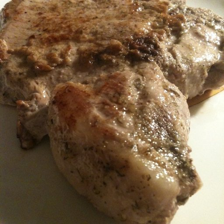

Model: n07873807  Predictions: pizza Confidence: 24.02%
Model: n07590611  Predictions: hot_pot Confidence: 18.40%
Model: n07613480  Predictions: trifle Confidence: 7.27%
Model: n04596742  Predictions: wok Confidence: 5.47%
Model: n01978287  Predictions: Dungeness_crab Confidence: 5.43%


Image name: not_pizza\1070867.jpg


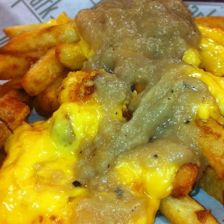

Model: n07873807  Predictions: pizza Confidence: 97.86%
Model: n07880968  Predictions: burrito Confidence: 1.02%
Model: n07684084  Predictions: French_loaf Confidence: 0.54%
Model: n07875152  Predictions: potpie Confidence: 0.37%
Model: n07579787  Predictions: plate Confidence: 0.07%


Image name: not_pizza\107499.jpg


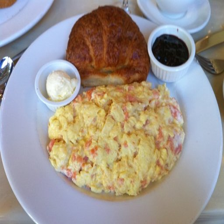

Model: n07873807  Predictions: pizza Confidence: 97.68%
Model: n03400231  Predictions: frying_pan Confidence: 1.32%
Model: n03259280  Predictions: Dutch_oven Confidence: 0.29%
Model: n02939185  Predictions: caldron Confidence: 0.23%
Model: n04111531  Predictions: rotisserie Confidence: 0.10%


Image name: not_pizza\108055.jpg


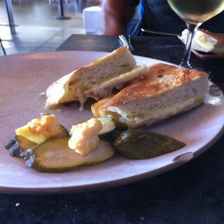

Model: n07873807  Predictions: pizza Confidence: 97.88%
Model: n07875152  Predictions: potpie Confidence: 1.63%
Model: n07579787  Predictions: plate Confidence: 0.16%
Model: n07880968  Predictions: burrito Confidence: 0.13%
Model: n03887697  Predictions: paper_towel Confidence: 0.06%


Image name: not_pizza\1081875.jpg


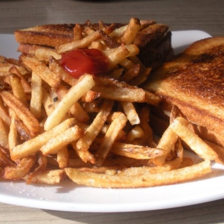

Model: n07873807  Predictions: pizza Confidence: 86.04%
Model: n04081281  Predictions: restaurant Confidence: 2.07%
Model: n07875152  Predictions: potpie Confidence: 2.04%
Model: n03400231  Predictions: frying_pan Confidence: 1.81%
Model: n04542943  Predictions: waffle_iron Confidence: 1.63%


Image name: not_pizza\1083749.jpg


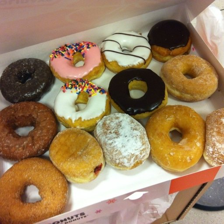

Model: n07873807  Predictions: pizza Confidence: 99.37%
Model: n07579787  Predictions: plate Confidence: 0.13%
Model: n03400231  Predictions: frying_pan Confidence: 0.10%
Model: n07684084  Predictions: French_loaf Confidence: 0.09%
Model: n07613480  Predictions: trifle Confidence: 0.05%




In [19]:
# Printing classification results for ResNet50
print_classification_results(pizza_images, pizza_image_paths, resultRN50, do_save=True, save_path='./results/resnet50/pizza')
print_classification_results(not_pizza_images, not_pizza_image_paths, resultRN50, do_save=True, save_path='./results/resnet50/not_pizza')

Image name: pizza\1001116.jpg


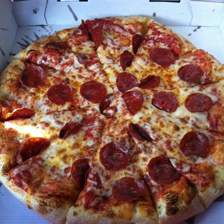

Model: n07873807  Predictions: pizza Confidence: 99.99%
Model: n07684084  Predictions: French_loaf Confidence: 0.00%
Model: n02776631  Predictions: bakery Confidence: 0.00%
Model: n03400231  Predictions: frying_pan Confidence: 0.00%
Model: n04270147  Predictions: spatula Confidence: 0.00%


Image name: pizza\1008104.jpg


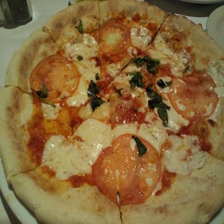

Model: n07873807  Predictions: pizza Confidence: 92.92%
Model: n07693725  Predictions: bagel Confidence: 1.53%
Model: n03400231  Predictions: frying_pan Confidence: 0.59%
Model: n07875152  Predictions: potpie Confidence: 0.56%
Model: n07684084  Predictions: French_loaf Confidence: 0.45%


Image name: pizza\1008144.jpg


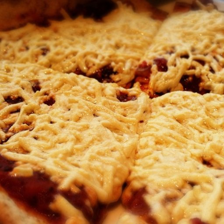

Model: n07693725  Predictions: bagel Confidence: 25.31%
Model: n07684084  Predictions: French_loaf Confidence: 22.96%
Model: n07831146  Predictions: carbonara Confidence: 14.91%
Model: n07873807  Predictions: pizza Confidence: 8.43%
Model: n07697313  Predictions: cheeseburger Confidence: 5.23%


Image name: pizza\1008844.jpg


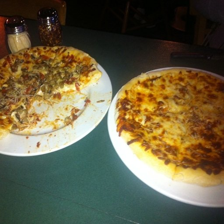

Model: n07873807  Predictions: pizza Confidence: 88.83%
Model: n07875152  Predictions: potpie Confidence: 4.46%
Model: n07579787  Predictions: plate Confidence: 1.83%
Model: n07717410  Predictions: acorn_squash Confidence: 0.39%
Model: n02776631  Predictions: bakery Confidence: 0.31%


Image name: pizza\1008941.jpg


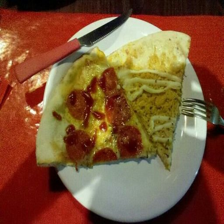

Model: n07880968  Predictions: burrito Confidence: 82.89%
Model: n07873807  Predictions: pizza Confidence: 4.71%
Model: n07583066  Predictions: guacamole Confidence: 2.96%
Model: n07697537  Predictions: hotdog Confidence: 2.79%
Model: n07579787  Predictions: plate Confidence: 1.56%


Image name: pizza\1011404.jpg


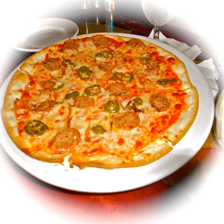

Model: n07873807  Predictions: pizza Confidence: 99.09%
Model: n07579787  Predictions: plate Confidence: 0.27%
Model: n07871810  Predictions: meat_loaf Confidence: 0.15%
Model: n07875152  Predictions: potpie Confidence: 0.08%
Model: n07716906  Predictions: spaghetti_squash Confidence: 0.06%


Image name: pizza\102037.jpg


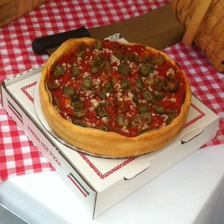

Model: n07873807  Predictions: pizza Confidence: 36.93%
Model: n07697537  Predictions: hotdog Confidence: 22.36%
Model: n07697313  Predictions: cheeseburger Confidence: 4.93%
Model: n02776631  Predictions: bakery Confidence: 3.82%
Model: n04476259  Predictions: tray Confidence: 3.12%


Image name: pizza\1026922.jpg


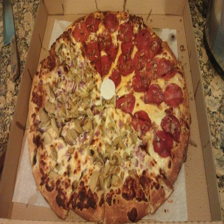

Model: n07873807  Predictions: pizza Confidence: 99.85%
Model: n04447861  Predictions: toilet_seat Confidence: 0.03%
Model: n07768694  Predictions: pomegranate Confidence: 0.02%
Model: n07693725  Predictions: bagel Confidence: 0.02%
Model: n02776631  Predictions: bakery Confidence: 0.01%


Image name: pizza\1029698.jpg


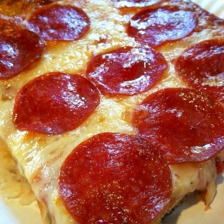

Model: n07873807  Predictions: pizza Confidence: 99.85%
Model: n07684084  Predictions: French_loaf Confidence: 0.03%
Model: n07875152  Predictions: potpie Confidence: 0.03%
Model: n07693725  Predictions: bagel Confidence: 0.01%
Model: n07871810  Predictions: meat_loaf Confidence: 0.01%


Image name: pizza\1032754.jpg


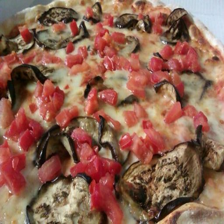

Model: n07768694  Predictions: pomegranate Confidence: 36.89%
Model: n07873807  Predictions: pizza Confidence: 24.07%
Model: n07613480  Predictions: trifle Confidence: 10.51%
Model: n07614500  Predictions: ice_cream Confidence: 5.27%
Model: n02776631  Predictions: bakery Confidence: 3.72%


Image name: pizza\1033251.jpg


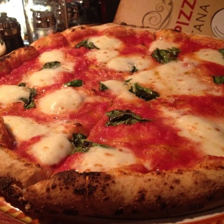

Model: n07873807  Predictions: pizza Confidence: 99.90%
Model: n03400231  Predictions: frying_pan Confidence: 0.03%
Model: n07613480  Predictions: trifle Confidence: 0.01%
Model: n07684084  Predictions: French_loaf Confidence: 0.01%
Model: n07697313  Predictions: cheeseburger Confidence: 0.01%


Image name: pizza\1035854.jpg


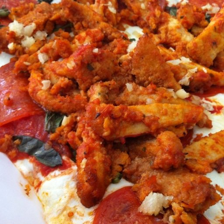

Model: n07880968  Predictions: burrito Confidence: 40.95%
Model: n07873807  Predictions: pizza Confidence: 32.19%
Model: n07579787  Predictions: plate Confidence: 3.19%
Model: n01981276  Predictions: king_crab Confidence: 3.17%
Model: n07583066  Predictions: guacamole Confidence: 2.32%


Image name: pizza\103708.jpg


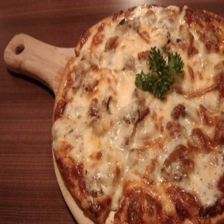

Model: n07873807  Predictions: pizza Confidence: 82.89%
Model: n07875152  Predictions: potpie Confidence: 2.43%
Model: n07693725  Predictions: bagel Confidence: 2.17%
Model: n07711569  Predictions: mashed_potato Confidence: 1.69%
Model: n07579787  Predictions: plate Confidence: 1.38%


Image name: pizza\1038357.jpg


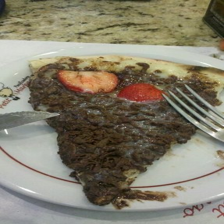

Model: n07871810  Predictions: meat_loaf Confidence: 25.39%
Model: n07613480  Predictions: trifle Confidence: 25.09%
Model: n07836838  Predictions: chocolate_sauce Confidence: 20.54%
Model: n07579787  Predictions: plate Confidence: 7.63%
Model: n07614500  Predictions: ice_cream Confidence: 6.23%


Image name: pizza\1040878.jpg


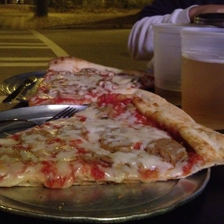

Model: n07873807  Predictions: pizza Confidence: 83.75%
Model: n03400231  Predictions: frying_pan Confidence: 5.07%
Model: n04270147  Predictions: spatula Confidence: 2.46%
Model: n07871810  Predictions: meat_loaf Confidence: 1.90%
Model: n07875152  Predictions: potpie Confidence: 0.94%


Image name: pizza\1044524.jpg


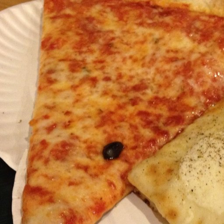

Model: n07873807  Predictions: pizza Confidence: 97.60%
Model: n07684084  Predictions: French_loaf Confidence: 1.01%
Model: n07875152  Predictions: potpie Confidence: 0.44%
Model: n07880968  Predictions: burrito Confidence: 0.37%
Model: n03400231  Predictions: frying_pan Confidence: 0.17%


Image name: pizza\1044789.jpg


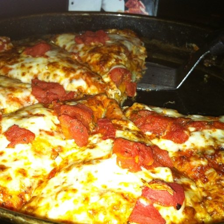

Model: n07873807  Predictions: pizza Confidence: 89.07%
Model: n03400231  Predictions: frying_pan Confidence: 4.37%
Model: n04111531  Predictions: rotisserie Confidence: 2.83%
Model: n03259280  Predictions: Dutch_oven Confidence: 1.10%
Model: n04270147  Predictions: spatula Confidence: 0.99%


Image name: pizza\1048649.jpg


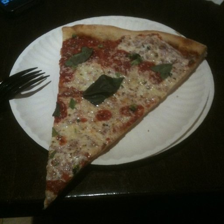

Model: n07873807  Predictions: pizza Confidence: 87.85%
Model: n04270147  Predictions: spatula Confidence: 3.03%
Model: n07880968  Predictions: burrito Confidence: 2.77%
Model: n03400231  Predictions: frying_pan Confidence: 1.01%
Model: n07579787  Predictions: plate Confidence: 0.76%


Image name: pizza\1054420.jpg


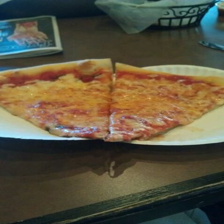

Model: n07873807  Predictions: pizza Confidence: 62.10%
Model: n07880968  Predictions: burrito Confidence: 4.98%
Model: n07579787  Predictions: plate Confidence: 3.37%
Model: n07871810  Predictions: meat_loaf Confidence: 3.34%
Model: n07697537  Predictions: hotdog Confidence: 1.95%


Image name: pizza\1055065.jpg


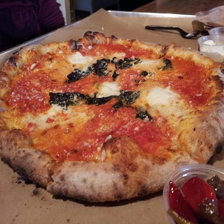

Model: n07873807  Predictions: pizza Confidence: 99.96%
Model: n03400231  Predictions: frying_pan Confidence: 0.01%
Model: n04270147  Predictions: spatula Confidence: 0.01%
Model: n07716358  Predictions: zucchini Confidence: 0.00%
Model: n07684084  Predictions: French_loaf Confidence: 0.00%


Image name: not_pizza\1005746.jpg


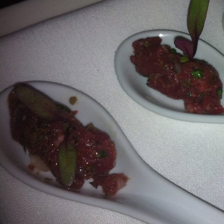

Model: n07873807  Predictions: pizza Confidence: 99.99%
Model: n07684084  Predictions: French_loaf Confidence: 0.00%
Model: n02776631  Predictions: bakery Confidence: 0.00%
Model: n03400231  Predictions: frying_pan Confidence: 0.00%
Model: n04270147  Predictions: spatula Confidence: 0.00%


Image name: not_pizza\1009225.jpg


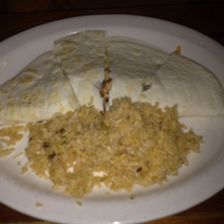

Model: n07873807  Predictions: pizza Confidence: 92.92%
Model: n07693725  Predictions: bagel Confidence: 1.53%
Model: n03400231  Predictions: frying_pan Confidence: 0.59%
Model: n07875152  Predictions: potpie Confidence: 0.56%
Model: n07684084  Predictions: French_loaf Confidence: 0.45%


Image name: not_pizza\1012312.jpg


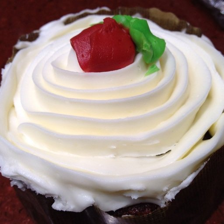

Model: n07693725  Predictions: bagel Confidence: 25.31%
Model: n07684084  Predictions: French_loaf Confidence: 22.96%
Model: n07831146  Predictions: carbonara Confidence: 14.91%
Model: n07873807  Predictions: pizza Confidence: 8.43%
Model: n07697313  Predictions: cheeseburger Confidence: 5.23%


Image name: not_pizza\1018802.jpg


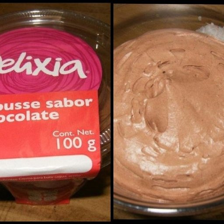

Model: n07873807  Predictions: pizza Confidence: 88.83%
Model: n07875152  Predictions: potpie Confidence: 4.46%
Model: n07579787  Predictions: plate Confidence: 1.83%
Model: n07717410  Predictions: acorn_squash Confidence: 0.39%
Model: n02776631  Predictions: bakery Confidence: 0.31%


Image name: not_pizza\1020735.jpg


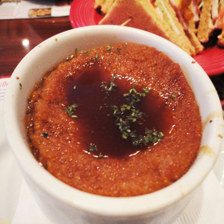

Model: n07880968  Predictions: burrito Confidence: 82.89%
Model: n07873807  Predictions: pizza Confidence: 4.71%
Model: n07583066  Predictions: guacamole Confidence: 2.96%
Model: n07697537  Predictions: hotdog Confidence: 2.79%
Model: n07579787  Predictions: plate Confidence: 1.56%


Image name: not_pizza\1027142.jpg


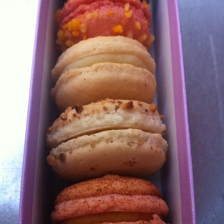

Model: n07873807  Predictions: pizza Confidence: 99.09%
Model: n07579787  Predictions: plate Confidence: 0.27%
Model: n07871810  Predictions: meat_loaf Confidence: 0.15%
Model: n07875152  Predictions: potpie Confidence: 0.08%
Model: n07716906  Predictions: spaghetti_squash Confidence: 0.06%


Image name: not_pizza\102839.jpg


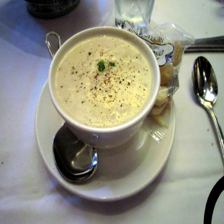

Model: n07873807  Predictions: pizza Confidence: 36.93%
Model: n07697537  Predictions: hotdog Confidence: 22.36%
Model: n07697313  Predictions: cheeseburger Confidence: 4.93%
Model: n02776631  Predictions: bakery Confidence: 3.82%
Model: n04476259  Predictions: tray Confidence: 3.12%


Image name: not_pizza\1043233.jpg


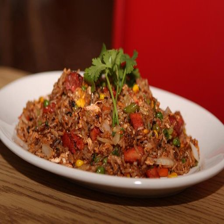

Model: n07873807  Predictions: pizza Confidence: 99.85%
Model: n04447861  Predictions: toilet_seat Confidence: 0.03%
Model: n07768694  Predictions: pomegranate Confidence: 0.02%
Model: n07693725  Predictions: bagel Confidence: 0.02%
Model: n02776631  Predictions: bakery Confidence: 0.01%


Image name: not_pizza\1045400.jpg


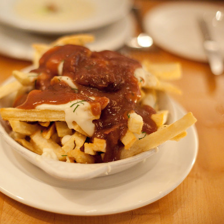

Model: n07873807  Predictions: pizza Confidence: 99.85%
Model: n07684084  Predictions: French_loaf Confidence: 0.03%
Model: n07875152  Predictions: potpie Confidence: 0.03%
Model: n07693725  Predictions: bagel Confidence: 0.01%
Model: n07871810  Predictions: meat_loaf Confidence: 0.01%


Image name: not_pizza\104773.jpg


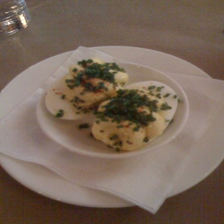

Model: n07768694  Predictions: pomegranate Confidence: 36.89%
Model: n07873807  Predictions: pizza Confidence: 24.07%
Model: n07613480  Predictions: trifle Confidence: 10.51%
Model: n07614500  Predictions: ice_cream Confidence: 5.27%
Model: n02776631  Predictions: bakery Confidence: 3.72%


Image name: not_pizza\1050956.jpg


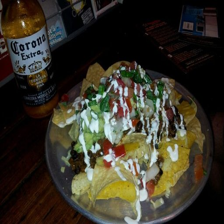

Model: n07873807  Predictions: pizza Confidence: 99.90%
Model: n03400231  Predictions: frying_pan Confidence: 0.03%
Model: n07613480  Predictions: trifle Confidence: 0.01%
Model: n07684084  Predictions: French_loaf Confidence: 0.01%
Model: n07697313  Predictions: cheeseburger Confidence: 0.01%


Image name: not_pizza\1054362.jpg


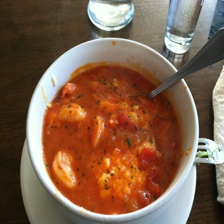

Model: n07880968  Predictions: burrito Confidence: 40.95%
Model: n07873807  Predictions: pizza Confidence: 32.19%
Model: n07579787  Predictions: plate Confidence: 3.19%
Model: n01981276  Predictions: king_crab Confidence: 3.17%
Model: n07583066  Predictions: guacamole Confidence: 2.32%


Image name: not_pizza\1062097.jpg


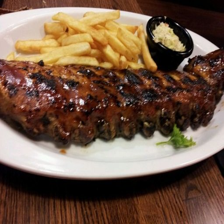

Model: n07873807  Predictions: pizza Confidence: 82.89%
Model: n07875152  Predictions: potpie Confidence: 2.43%
Model: n07693725  Predictions: bagel Confidence: 2.17%
Model: n07711569  Predictions: mashed_potato Confidence: 1.69%
Model: n07579787  Predictions: plate Confidence: 1.38%


Image name: not_pizza\1066151.jpg


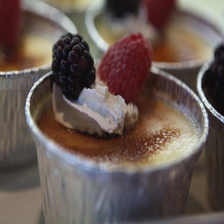

Model: n07871810  Predictions: meat_loaf Confidence: 25.39%
Model: n07613480  Predictions: trifle Confidence: 25.09%
Model: n07836838  Predictions: chocolate_sauce Confidence: 20.54%
Model: n07579787  Predictions: plate Confidence: 7.63%
Model: n07614500  Predictions: ice_cream Confidence: 6.23%


Image name: not_pizza\1070772.jpg


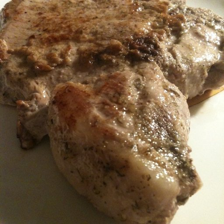

Model: n07873807  Predictions: pizza Confidence: 83.75%
Model: n03400231  Predictions: frying_pan Confidence: 5.07%
Model: n04270147  Predictions: spatula Confidence: 2.46%
Model: n07871810  Predictions: meat_loaf Confidence: 1.90%
Model: n07875152  Predictions: potpie Confidence: 0.94%


Image name: not_pizza\1070867.jpg


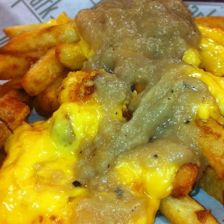

Model: n07873807  Predictions: pizza Confidence: 97.60%
Model: n07684084  Predictions: French_loaf Confidence: 1.01%
Model: n07875152  Predictions: potpie Confidence: 0.44%
Model: n07880968  Predictions: burrito Confidence: 0.37%
Model: n03400231  Predictions: frying_pan Confidence: 0.17%


Image name: not_pizza\107499.jpg


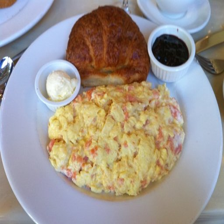

Model: n07873807  Predictions: pizza Confidence: 89.07%
Model: n03400231  Predictions: frying_pan Confidence: 4.37%
Model: n04111531  Predictions: rotisserie Confidence: 2.83%
Model: n03259280  Predictions: Dutch_oven Confidence: 1.10%
Model: n04270147  Predictions: spatula Confidence: 0.99%


Image name: not_pizza\108055.jpg


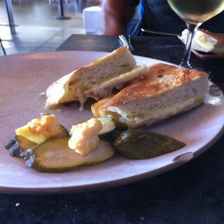

Model: n07873807  Predictions: pizza Confidence: 87.85%
Model: n04270147  Predictions: spatula Confidence: 3.03%
Model: n07880968  Predictions: burrito Confidence: 2.77%
Model: n03400231  Predictions: frying_pan Confidence: 1.01%
Model: n07579787  Predictions: plate Confidence: 0.76%


Image name: not_pizza\1081875.jpg


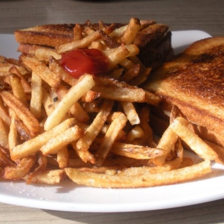

Model: n07873807  Predictions: pizza Confidence: 62.10%
Model: n07880968  Predictions: burrito Confidence: 4.98%
Model: n07579787  Predictions: plate Confidence: 3.37%
Model: n07871810  Predictions: meat_loaf Confidence: 3.34%
Model: n07697537  Predictions: hotdog Confidence: 1.95%


Image name: not_pizza\1083749.jpg


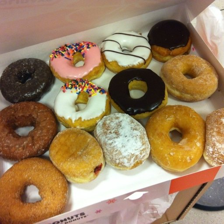

Model: n07873807  Predictions: pizza Confidence: 99.96%
Model: n03400231  Predictions: frying_pan Confidence: 0.01%
Model: n04270147  Predictions: spatula Confidence: 0.01%
Model: n07716358  Predictions: zucchini Confidence: 0.00%
Model: n07684084  Predictions: French_loaf Confidence: 0.00%




In [20]:
# Printing classification results for VGG16
print_classification_results(pizza_images, pizza_image_paths, resultV16, do_save=True, save_path='./results/vgg16/pizza')
print_classification_results(not_pizza_images, not_pizza_image_paths, resultV16, do_save=True, save_path='./results/vgg16/not_pizza')

Image name: pizza\1001116.jpg


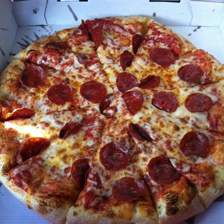

Model: n04325704  Predictions: stole Confidence: 68.16%
Model: n03980874  Predictions: poncho Confidence: 11.99%
Model: n02869837  Predictions: bonnet Confidence: 9.25%
Model: n02834397  Predictions: bib Confidence: 5.17%
Model: n04026417  Predictions: purse Confidence: 1.58%


Image name: pizza\1008104.jpg


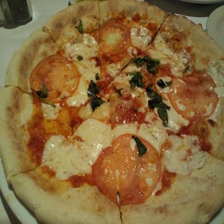

Model: n04033995  Predictions: quilt Confidence: 30.52%
Model: n02834397  Predictions: bib Confidence: 8.29%
Model: n04209133  Predictions: shower_cap Confidence: 5.54%
Model: n02808304  Predictions: bath_towel Confidence: 2.60%
Model: n03642806  Predictions: laptop Confidence: 2.50%


Image name: pizza\1008144.jpg


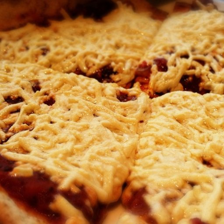

Model: n04325704  Predictions: stole Confidence: 22.62%
Model: n04033995  Predictions: quilt Confidence: 16.96%
Model: n09193705  Predictions: alp Confidence: 9.91%
Model: n03980874  Predictions: poncho Confidence: 9.65%
Model: n03485794  Predictions: handkerchief Confidence: 4.92%


Image name: pizza\1008844.jpg


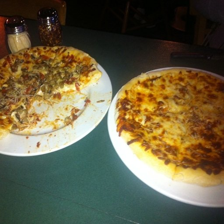

Model: n04118538  Predictions: rugby_ball Confidence: 20.20%
Model: n03598930  Predictions: jigsaw_puzzle Confidence: 16.60%
Model: n03775546  Predictions: mixing_bowl Confidence: 9.80%
Model: n07248320  Predictions: book_jacket Confidence: 7.71%
Model: n03314780  Predictions: face_powder Confidence: 6.62%


Image name: pizza\1008941.jpg


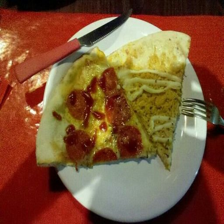

Model: n02834397  Predictions: bib Confidence: 16.01%
Model: n04127249  Predictions: safety_pin Confidence: 7.98%
Model: n03485794  Predictions: handkerchief Confidence: 7.02%
Model: n04476259  Predictions: tray Confidence: 3.86%
Model: n03980874  Predictions: poncho Confidence: 3.85%


Image name: pizza\1011404.jpg


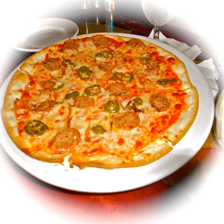

Model: n04328186  Predictions: stopwatch Confidence: 31.84%
Model: n04263257  Predictions: soup_bowl Confidence: 10.48%
Model: n04599235  Predictions: wool Confidence: 6.99%
Model: n07579787  Predictions: plate Confidence: 5.34%
Model: n04476259  Predictions: tray Confidence: 4.46%


Image name: pizza\102037.jpg


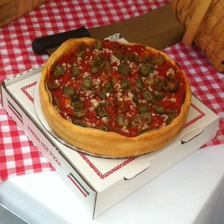

Model: n03291819  Predictions: envelope Confidence: 20.14%
Model: n03788365  Predictions: mosquito_net Confidence: 18.62%
Model: n03485794  Predictions: handkerchief Confidence: 15.43%
Model: n04204238  Predictions: shopping_basket Confidence: 11.13%
Model: n03482405  Predictions: hamper Confidence: 9.79%


Image name: pizza\1026922.jpg


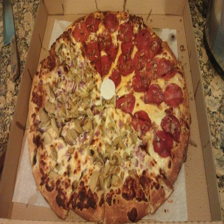

Model: n03207743  Predictions: dishrag Confidence: 33.25%
Model: n03598930  Predictions: jigsaw_puzzle Confidence: 22.46%
Model: n04325704  Predictions: stole Confidence: 13.80%
Model: n03980874  Predictions: poncho Confidence: 5.58%
Model: n04209239  Predictions: shower_curtain Confidence: 4.42%


Image name: pizza\1029698.jpg


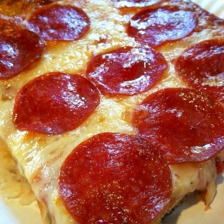

Model: n03485794  Predictions: handkerchief Confidence: 43.87%
Model: n02834397  Predictions: bib Confidence: 11.73%
Model: n04033995  Predictions: quilt Confidence: 8.16%
Model: n03598930  Predictions: jigsaw_puzzle Confidence: 5.63%
Model: n04209239  Predictions: shower_curtain Confidence: 4.27%


Image name: pizza\1032754.jpg


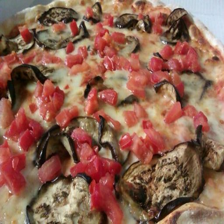

Model: n04033995  Predictions: quilt Confidence: 35.31%
Model: n02730930  Predictions: apron Confidence: 9.81%
Model: n04136333  Predictions: sarong Confidence: 8.91%
Model: n04371430  Predictions: swimming_trunks Confidence: 6.29%
Model: n04209239  Predictions: shower_curtain Confidence: 4.88%


Image name: pizza\1033251.jpg


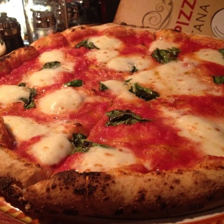

Model: n04033995  Predictions: quilt Confidence: 74.53%
Model: n04209239  Predictions: shower_curtain Confidence: 4.50%
Model: n03998194  Predictions: prayer_rug Confidence: 2.77%
Model: n03485794  Predictions: handkerchief Confidence: 1.93%
Model: n04525038  Predictions: velvet Confidence: 1.55%


Image name: pizza\1035854.jpg


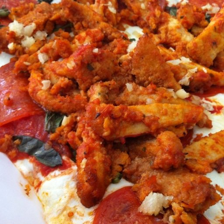

Model: n04033995  Predictions: quilt Confidence: 95.00%
Model: n04209239  Predictions: shower_curtain Confidence: 1.77%
Model: n03485794  Predictions: handkerchief Confidence: 0.99%
Model: n04525038  Predictions: velvet Confidence: 0.50%
Model: n03998194  Predictions: prayer_rug Confidence: 0.43%


Image name: pizza\103708.jpg


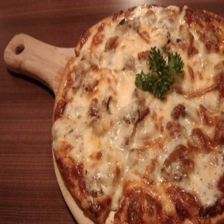

Model: n02834397  Predictions: bib Confidence: 59.83%
Model: n15075141  Predictions: toilet_tissue Confidence: 3.91%
Model: n04525038  Predictions: velvet Confidence: 2.96%
Model: n04548280  Predictions: wall_clock Confidence: 2.68%
Model: n03775071  Predictions: mitten Confidence: 2.16%


Image name: pizza\1038357.jpg


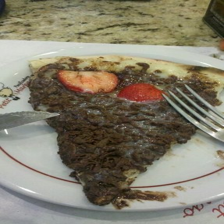

Model: n03598930  Predictions: jigsaw_puzzle Confidence: 93.22%
Model: n04033995  Predictions: quilt Confidence: 1.79%
Model: n03207743  Predictions: dishrag Confidence: 0.40%
Model: n03733281  Predictions: maze Confidence: 0.40%
Model: n03980874  Predictions: poncho Confidence: 0.39%


Image name: pizza\1040878.jpg


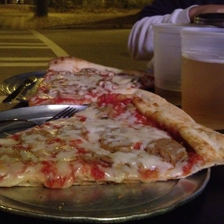

Model: n03598930  Predictions: jigsaw_puzzle Confidence: 31.85%
Model: n04033995  Predictions: quilt Confidence: 17.50%
Model: n03485794  Predictions: handkerchief Confidence: 8.49%
Model: n03709823  Predictions: mailbag Confidence: 6.60%
Model: n02834397  Predictions: bib Confidence: 3.89%


Image name: pizza\1044524.jpg


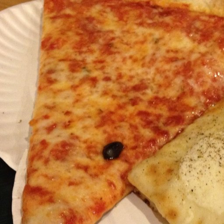

Model: n04033995  Predictions: quilt Confidence: 24.41%
Model: n04371430  Predictions: swimming_trunks Confidence: 9.08%
Model: n04548280  Predictions: wall_clock Confidence: 7.87%
Model: n04258138  Predictions: solar_dish Confidence: 6.85%
Model: n03642806  Predictions: laptop Confidence: 6.40%


Image name: pizza\1044789.jpg


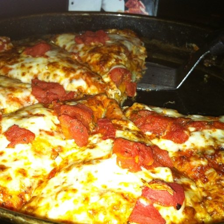

Model: n03598930  Predictions: jigsaw_puzzle Confidence: 70.77%
Model: n04033995  Predictions: quilt Confidence: 27.48%
Model: n03291819  Predictions: envelope Confidence: 0.54%
Model: n04525038  Predictions: velvet Confidence: 0.18%
Model: n03642806  Predictions: laptop Confidence: 0.15%


Image name: pizza\1048649.jpg


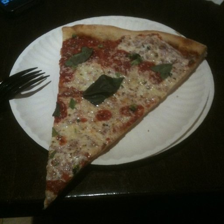

Model: n03598930  Predictions: jigsaw_puzzle Confidence: 13.84%
Model: n03485794  Predictions: handkerchief Confidence: 9.42%
Model: n02869837  Predictions: bonnet Confidence: 8.62%
Model: n04548362  Predictions: wallet Confidence: 7.71%
Model: n04507155  Predictions: umbrella Confidence: 7.20%


Image name: pizza\1054420.jpg


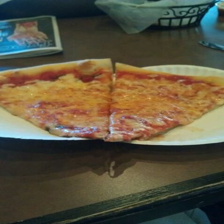

Model: n03598930  Predictions: jigsaw_puzzle Confidence: 95.59%
Model: n03871628  Predictions: packet Confidence: 0.77%
Model: n02971356  Predictions: carton Confidence: 0.67%
Model: n03998194  Predictions: prayer_rug Confidence: 0.48%
Model: n04493381  Predictions: tub Confidence: 0.34%


Image name: pizza\1055065.jpg


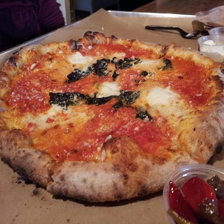

Model: n03485794  Predictions: handkerchief Confidence: 42.03%
Model: n02730930  Predictions: apron Confidence: 17.03%
Model: n04033995  Predictions: quilt Confidence: 12.69%
Model: n03598930  Predictions: jigsaw_puzzle Confidence: 4.02%
Model: n02834397  Predictions: bib Confidence: 3.73%


Image name: not_pizza\1005746.jpg


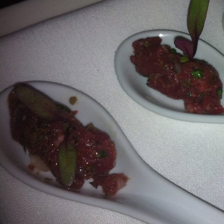

Model: n04325704  Predictions: stole Confidence: 68.16%
Model: n03980874  Predictions: poncho Confidence: 11.99%
Model: n02869837  Predictions: bonnet Confidence: 9.25%
Model: n02834397  Predictions: bib Confidence: 5.17%
Model: n04026417  Predictions: purse Confidence: 1.58%


Image name: not_pizza\1009225.jpg


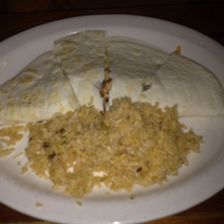

Model: n04033995  Predictions: quilt Confidence: 30.52%
Model: n02834397  Predictions: bib Confidence: 8.29%
Model: n04209133  Predictions: shower_cap Confidence: 5.54%
Model: n02808304  Predictions: bath_towel Confidence: 2.60%
Model: n03642806  Predictions: laptop Confidence: 2.50%


Image name: not_pizza\1012312.jpg


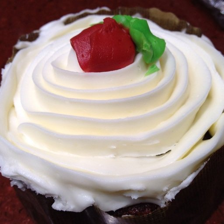

Model: n04325704  Predictions: stole Confidence: 22.62%
Model: n04033995  Predictions: quilt Confidence: 16.96%
Model: n09193705  Predictions: alp Confidence: 9.91%
Model: n03980874  Predictions: poncho Confidence: 9.65%
Model: n03485794  Predictions: handkerchief Confidence: 4.92%


Image name: not_pizza\1018802.jpg


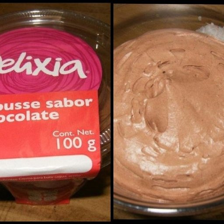

Model: n04118538  Predictions: rugby_ball Confidence: 20.20%
Model: n03598930  Predictions: jigsaw_puzzle Confidence: 16.60%
Model: n03775546  Predictions: mixing_bowl Confidence: 9.80%
Model: n07248320  Predictions: book_jacket Confidence: 7.71%
Model: n03314780  Predictions: face_powder Confidence: 6.62%


Image name: not_pizza\1020735.jpg


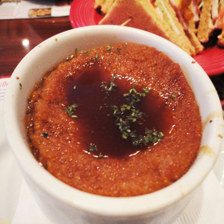

Model: n02834397  Predictions: bib Confidence: 16.01%
Model: n04127249  Predictions: safety_pin Confidence: 7.98%
Model: n03485794  Predictions: handkerchief Confidence: 7.02%
Model: n04476259  Predictions: tray Confidence: 3.86%
Model: n03980874  Predictions: poncho Confidence: 3.85%


Image name: not_pizza\1027142.jpg


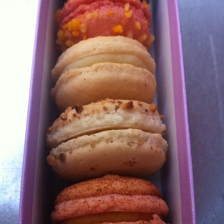

Model: n04328186  Predictions: stopwatch Confidence: 31.84%
Model: n04263257  Predictions: soup_bowl Confidence: 10.48%
Model: n04599235  Predictions: wool Confidence: 6.99%
Model: n07579787  Predictions: plate Confidence: 5.34%
Model: n04476259  Predictions: tray Confidence: 4.46%


Image name: not_pizza\102839.jpg


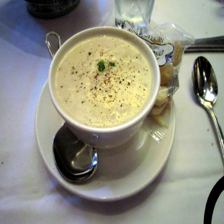

Model: n03291819  Predictions: envelope Confidence: 20.14%
Model: n03788365  Predictions: mosquito_net Confidence: 18.62%
Model: n03485794  Predictions: handkerchief Confidence: 15.43%
Model: n04204238  Predictions: shopping_basket Confidence: 11.13%
Model: n03482405  Predictions: hamper Confidence: 9.79%


Image name: not_pizza\1043233.jpg


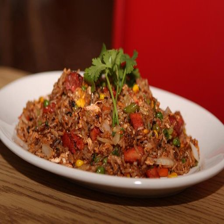

Model: n03207743  Predictions: dishrag Confidence: 33.25%
Model: n03598930  Predictions: jigsaw_puzzle Confidence: 22.46%
Model: n04325704  Predictions: stole Confidence: 13.80%
Model: n03980874  Predictions: poncho Confidence: 5.58%
Model: n04209239  Predictions: shower_curtain Confidence: 4.42%


Image name: not_pizza\1045400.jpg


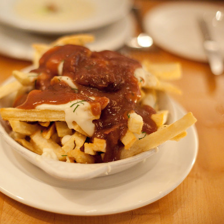

Model: n03485794  Predictions: handkerchief Confidence: 43.87%
Model: n02834397  Predictions: bib Confidence: 11.73%
Model: n04033995  Predictions: quilt Confidence: 8.16%
Model: n03598930  Predictions: jigsaw_puzzle Confidence: 5.63%
Model: n04209239  Predictions: shower_curtain Confidence: 4.27%


Image name: not_pizza\104773.jpg


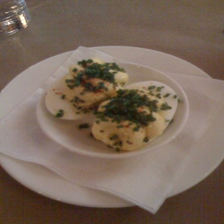

Model: n04033995  Predictions: quilt Confidence: 35.31%
Model: n02730930  Predictions: apron Confidence: 9.81%
Model: n04136333  Predictions: sarong Confidence: 8.91%
Model: n04371430  Predictions: swimming_trunks Confidence: 6.29%
Model: n04209239  Predictions: shower_curtain Confidence: 4.88%


Image name: not_pizza\1050956.jpg


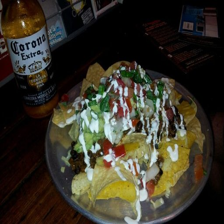

Model: n04033995  Predictions: quilt Confidence: 74.53%
Model: n04209239  Predictions: shower_curtain Confidence: 4.50%
Model: n03998194  Predictions: prayer_rug Confidence: 2.77%
Model: n03485794  Predictions: handkerchief Confidence: 1.93%
Model: n04525038  Predictions: velvet Confidence: 1.55%


Image name: not_pizza\1054362.jpg


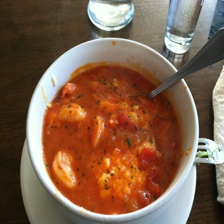

Model: n04033995  Predictions: quilt Confidence: 95.00%
Model: n04209239  Predictions: shower_curtain Confidence: 1.77%
Model: n03485794  Predictions: handkerchief Confidence: 0.99%
Model: n04525038  Predictions: velvet Confidence: 0.50%
Model: n03998194  Predictions: prayer_rug Confidence: 0.43%


Image name: not_pizza\1062097.jpg


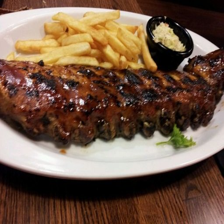

Model: n02834397  Predictions: bib Confidence: 59.83%
Model: n15075141  Predictions: toilet_tissue Confidence: 3.91%
Model: n04525038  Predictions: velvet Confidence: 2.96%
Model: n04548280  Predictions: wall_clock Confidence: 2.68%
Model: n03775071  Predictions: mitten Confidence: 2.16%


Image name: not_pizza\1066151.jpg


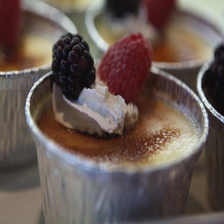

Model: n03598930  Predictions: jigsaw_puzzle Confidence: 93.22%
Model: n04033995  Predictions: quilt Confidence: 1.79%
Model: n03207743  Predictions: dishrag Confidence: 0.40%
Model: n03733281  Predictions: maze Confidence: 0.40%
Model: n03980874  Predictions: poncho Confidence: 0.39%


Image name: not_pizza\1070772.jpg


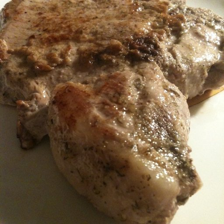

Model: n03598930  Predictions: jigsaw_puzzle Confidence: 31.85%
Model: n04033995  Predictions: quilt Confidence: 17.50%
Model: n03485794  Predictions: handkerchief Confidence: 8.49%
Model: n03709823  Predictions: mailbag Confidence: 6.60%
Model: n02834397  Predictions: bib Confidence: 3.89%


Image name: not_pizza\1070867.jpg


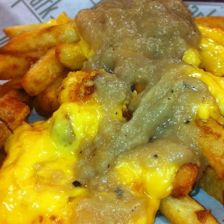

Model: n04033995  Predictions: quilt Confidence: 24.41%
Model: n04371430  Predictions: swimming_trunks Confidence: 9.08%
Model: n04548280  Predictions: wall_clock Confidence: 7.87%
Model: n04258138  Predictions: solar_dish Confidence: 6.85%
Model: n03642806  Predictions: laptop Confidence: 6.40%


Image name: not_pizza\107499.jpg


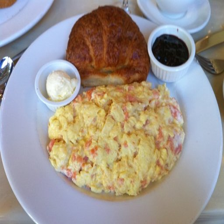

Model: n03598930  Predictions: jigsaw_puzzle Confidence: 70.77%
Model: n04033995  Predictions: quilt Confidence: 27.48%
Model: n03291819  Predictions: envelope Confidence: 0.54%
Model: n04525038  Predictions: velvet Confidence: 0.18%
Model: n03642806  Predictions: laptop Confidence: 0.15%


Image name: not_pizza\108055.jpg


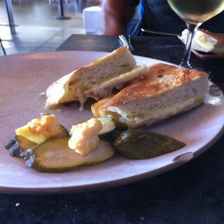

Model: n03598930  Predictions: jigsaw_puzzle Confidence: 13.84%
Model: n03485794  Predictions: handkerchief Confidence: 9.42%
Model: n02869837  Predictions: bonnet Confidence: 8.62%
Model: n04548362  Predictions: wallet Confidence: 7.71%
Model: n04507155  Predictions: umbrella Confidence: 7.20%


Image name: not_pizza\1081875.jpg


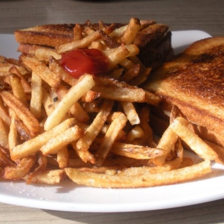

Model: n03598930  Predictions: jigsaw_puzzle Confidence: 95.59%
Model: n03871628  Predictions: packet Confidence: 0.77%
Model: n02971356  Predictions: carton Confidence: 0.67%
Model: n03998194  Predictions: prayer_rug Confidence: 0.48%
Model: n04493381  Predictions: tub Confidence: 0.34%


Image name: not_pizza\1083749.jpg


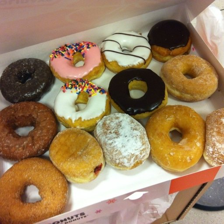

Model: n03485794  Predictions: handkerchief Confidence: 42.03%
Model: n02730930  Predictions: apron Confidence: 17.03%
Model: n04033995  Predictions: quilt Confidence: 12.69%
Model: n03598930  Predictions: jigsaw_puzzle Confidence: 4.02%
Model: n02834397  Predictions: bib Confidence: 3.73%




In [21]:
# Printing classification results for MobileNet
print_classification_results(pizza_images, pizza_image_paths, resultMN, do_save=True, save_path='./results/mobilenet/pizza')
print_classification_results(not_pizza_images, not_pizza_image_paths, resultMN, do_save=True, save_path='./results/mobilenet/not_pizza')

Image name: pizza\1001116.jpg


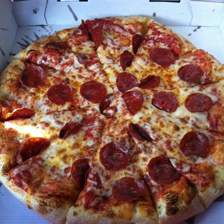

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: pizza\1008104.jpg


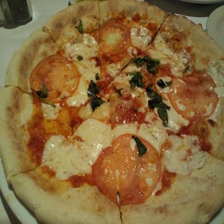

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%


Image name: pizza\1008144.jpg


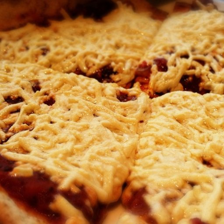

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02319095  Predictions: sea_urchin Confidence: 0.00%
Model: n02391049  Predictions: zebra Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: pizza\1008844.jpg


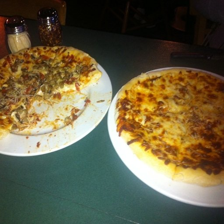

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%
Model: n03868863  Predictions: oxygen_mask Confidence: 0.00%


Image name: pizza\1008941.jpg


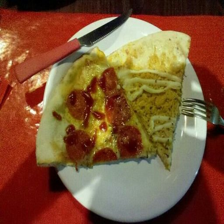

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02342885  Predictions: hamster Confidence: 0.00%


Image name: pizza\1011404.jpg


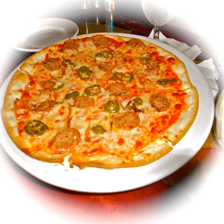

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02317335  Predictions: starfish Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: pizza\102037.jpg


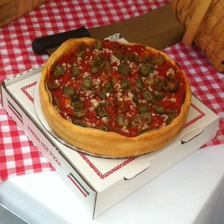

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02317335  Predictions: starfish Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: pizza\1026922.jpg


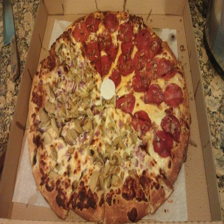

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: pizza\1029698.jpg


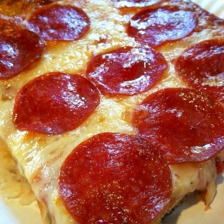

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%


Image name: pizza\1032754.jpg


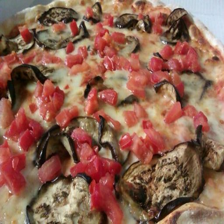

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02317335  Predictions: starfish Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: pizza\1033251.jpg


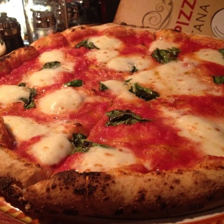

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: pizza\1035854.jpg


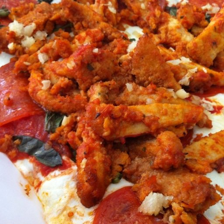

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: pizza\103708.jpg


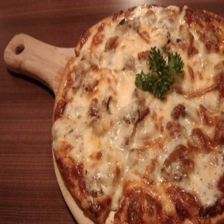

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: pizza\1038357.jpg


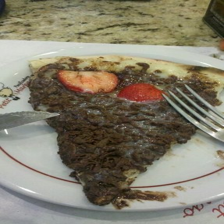

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%


Image name: pizza\1040878.jpg


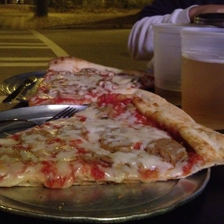

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%


Image name: pizza\1044524.jpg


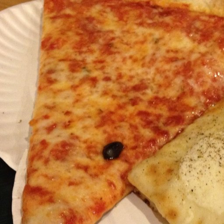

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: pizza\1044789.jpg


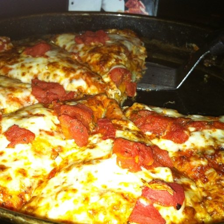

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02317335  Predictions: starfish Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: pizza\1048649.jpg


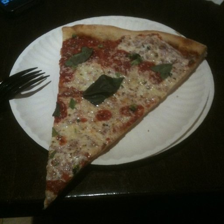

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02317335  Predictions: starfish Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: pizza\1054420.jpg


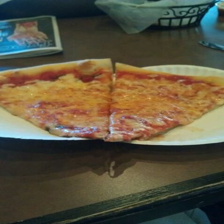

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%


Image name: pizza\1055065.jpg


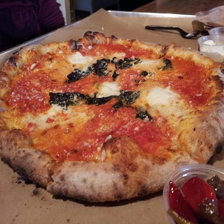

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02342885  Predictions: hamster Confidence: 0.00%


Image name: not_pizza\1005746.jpg


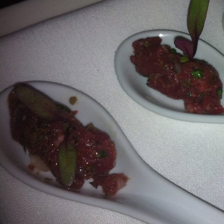

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: not_pizza\1009225.jpg


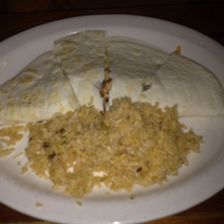

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%


Image name: not_pizza\1012312.jpg


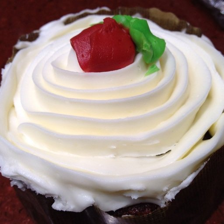

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02319095  Predictions: sea_urchin Confidence: 0.00%
Model: n02391049  Predictions: zebra Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: not_pizza\1018802.jpg


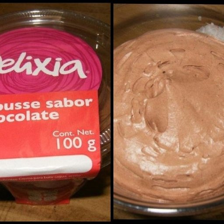

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%
Model: n03868863  Predictions: oxygen_mask Confidence: 0.00%


Image name: not_pizza\1020735.jpg


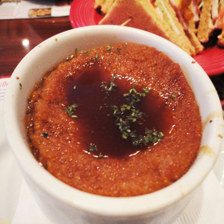

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02342885  Predictions: hamster Confidence: 0.00%


Image name: not_pizza\1027142.jpg


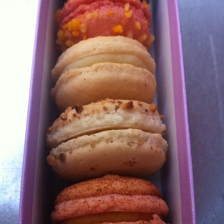

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02317335  Predictions: starfish Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: not_pizza\102839.jpg


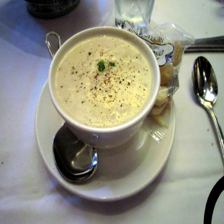

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02317335  Predictions: starfish Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: not_pizza\1043233.jpg


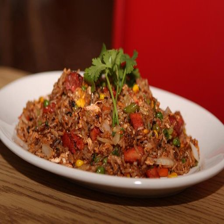

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: not_pizza\1045400.jpg


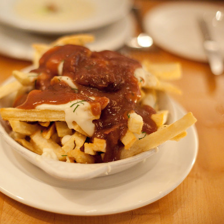

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%


Image name: not_pizza\104773.jpg


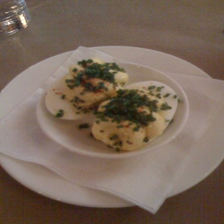

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02317335  Predictions: starfish Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: not_pizza\1050956.jpg


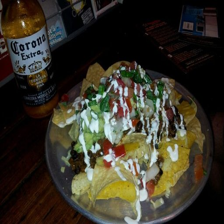

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: not_pizza\1054362.jpg


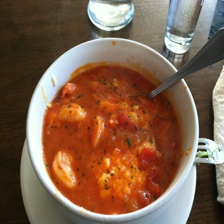

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: not_pizza\1062097.jpg


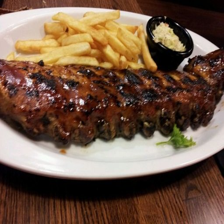

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: not_pizza\1066151.jpg


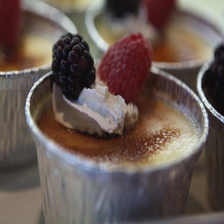

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%


Image name: not_pizza\1070772.jpg


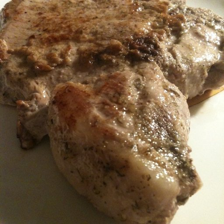

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%


Image name: not_pizza\1070867.jpg


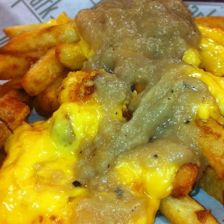

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n02321529  Predictions: sea_cucumber Confidence: 0.00%


Image name: not_pizza\107499.jpg


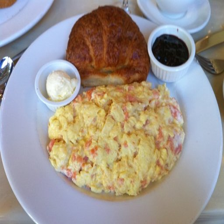

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02317335  Predictions: starfish Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: not_pizza\108055.jpg


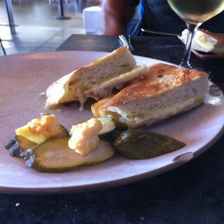

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02317335  Predictions: starfish Confidence: 0.00%
Model: n02389026  Predictions: sorrel Confidence: 0.00%


Image name: not_pizza\1081875.jpg


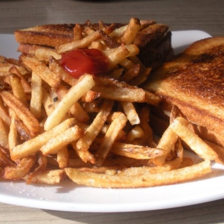

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n03794056  Predictions: mousetrap Confidence: 0.00%
Model: n03995372  Predictions: power_drill Confidence: 0.00%


Image name: not_pizza\1083749.jpg


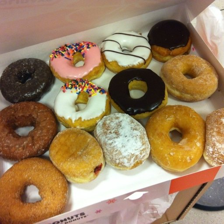

Model: n06596364  Predictions: comic_book Confidence: 100.00%
Model: n02791124  Predictions: barber_chair Confidence: 0.00%
Model: n04517823  Predictions: vacuum Confidence: 0.00%
Model: n15075141  Predictions: toilet_tissue Confidence: 0.00%
Model: n02342885  Predictions: hamster Confidence: 0.00%




In [22]:
# Printing classification results for InceptionResNetV2
print_classification_results(pizza_images, pizza_image_paths, resultIRN, do_save=True, save_path='./results/inceptionresnetv2/pizza')
print_classification_results(not_pizza_images, not_pizza_image_paths, resultIRN, do_save=True, save_path='./results/inceptionresnetv2/not_pizza')

Image name: pizza\1001116.jpg


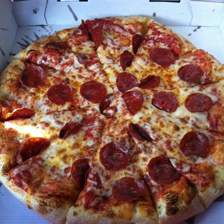

Model: n01496331  Predictions: electric_ray Confidence: 40.51%
Model: n04209133  Predictions: shower_cap Confidence: 19.03%
Model: n04447861  Predictions: toilet_seat Confidence: 5.74%
Model: n03775071  Predictions: mitten Confidence: 2.06%
Model: n02869837  Predictions: bonnet Confidence: 2.00%


Image name: pizza\1008104.jpg


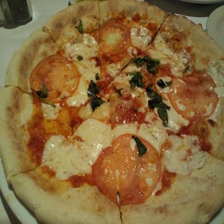

Model: n04447861  Predictions: toilet_seat Confidence: 49.92%
Model: n07873807  Predictions: pizza Confidence: 22.46%
Model: n04542943  Predictions: waffle_iron Confidence: 4.89%
Model: n07875152  Predictions: potpie Confidence: 2.67%
Model: n07613480  Predictions: trifle Confidence: 2.04%


Image name: pizza\1008144.jpg


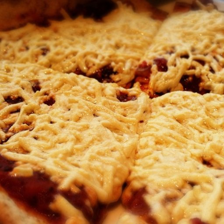

Model: n07860988  Predictions: dough Confidence: 45.41%
Model: n07875152  Predictions: potpie Confidence: 4.39%
Model: n04525038  Predictions: velvet Confidence: 1.86%
Model: n07684084  Predictions: French_loaf Confidence: 1.42%
Model: n01665541  Predictions: leatherback_turtle Confidence: 0.99%


Image name: pizza\1008844.jpg


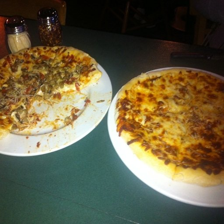

Model: n03920288  Predictions: Petri_dish Confidence: 32.18%
Model: n07932039  Predictions: eggnog Confidence: 18.39%
Model: n04447861  Predictions: toilet_seat Confidence: 9.77%
Model: n04258138  Predictions: solar_dish Confidence: 2.89%
Model: n07875152  Predictions: potpie Confidence: 2.03%


Image name: pizza\1008941.jpg


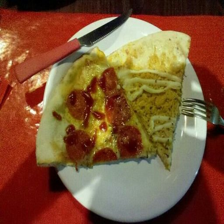

Model: n03929660  Predictions: pick Confidence: 45.67%
Model: n03476684  Predictions: hair_slide Confidence: 19.19%
Model: n02865351  Predictions: bolo_tie Confidence: 4.78%
Model: n04355933  Predictions: sunglass Confidence: 3.70%
Model: n07579787  Predictions: plate Confidence: 1.55%


Image name: pizza\1011404.jpg


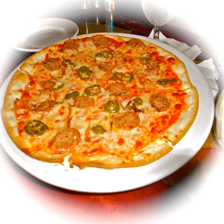

Model: n03314780  Predictions: face_powder Confidence: 61.08%
Model: n03920288  Predictions: Petri_dish Confidence: 5.46%
Model: n04286575  Predictions: spotlight Confidence: 3.15%
Model: n04447861  Predictions: toilet_seat Confidence: 2.12%
Model: n07875152  Predictions: potpie Confidence: 1.93%


Image name: pizza\102037.jpg


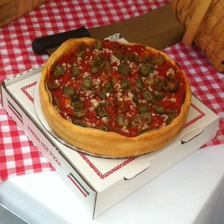

Model: n03920288  Predictions: Petri_dish Confidence: 26.18%
Model: n04447861  Predictions: toilet_seat Confidence: 7.83%
Model: n02808440  Predictions: bathtub Confidence: 4.32%
Model: n04493381  Predictions: tub Confidence: 3.93%
Model: n03400231  Predictions: frying_pan Confidence: 3.87%


Image name: pizza\1026922.jpg


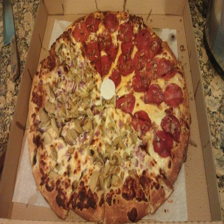

Model: n03447721  Predictions: gong Confidence: 54.12%
Model: n04447861  Predictions: toilet_seat Confidence: 15.52%
Model: n04209133  Predictions: shower_cap Confidence: 4.47%
Model: n04258138  Predictions: solar_dish Confidence: 2.54%
Model: n04553703  Predictions: washbasin Confidence: 1.06%


Image name: pizza\1029698.jpg


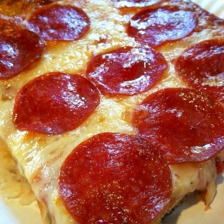

Model: n01753488  Predictions: horned_viper Confidence: 71.60%
Model: n01756291  Predictions: sidewinder Confidence: 3.57%
Model: n01742172  Predictions: boa_constrictor Confidence: 2.95%
Model: n01644900  Predictions: tailed_frog Confidence: 1.66%
Model: n07693725  Predictions: bagel Confidence: 1.20%


Image name: pizza\1032754.jpg


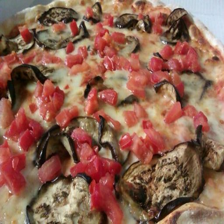

Model: n04525038  Predictions: velvet Confidence: 6.97%
Model: n02869837  Predictions: bonnet Confidence: 5.83%
Model: n04209133  Predictions: shower_cap Confidence: 5.52%
Model: n01496331  Predictions: electric_ray Confidence: 4.46%
Model: n07860988  Predictions: dough Confidence: 3.31%


Image name: pizza\1033251.jpg


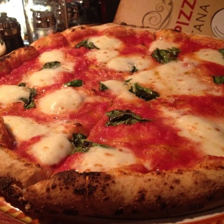

Model: n01496331  Predictions: electric_ray Confidence: 33.49%
Model: n01665541  Predictions: leatherback_turtle Confidence: 19.58%
Model: n01667778  Predictions: terrapin Confidence: 1.32%
Model: n01498041  Predictions: stingray Confidence: 1.30%
Model: n04033995  Predictions: quilt Confidence: 1.10%


Image name: pizza\1035854.jpg


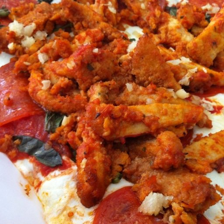

Model: n04325704  Predictions: stole Confidence: 45.04%
Model: n03207743  Predictions: dishrag Confidence: 27.77%
Model: n03980874  Predictions: poncho Confidence: 3.83%
Model: n02869837  Predictions: bonnet Confidence: 2.53%
Model: n02317335  Predictions: starfish Confidence: 1.52%


Image name: pizza\103708.jpg


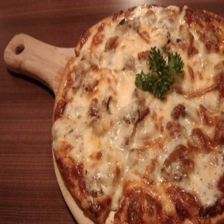

Model: n04542943  Predictions: waffle_iron Confidence: 38.14%
Model: n03400231  Predictions: frying_pan Confidence: 27.61%
Model: n04270147  Predictions: spatula Confidence: 4.20%
Model: n07875152  Predictions: potpie Confidence: 2.15%
Model: n07860988  Predictions: dough Confidence: 2.13%


Image name: pizza\1038357.jpg


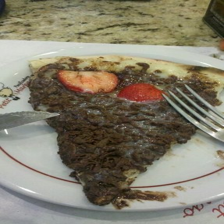

Model: n07579787  Predictions: plate Confidence: 59.54%
Model: n04447861  Predictions: toilet_seat Confidence: 3.79%
Model: n07584110  Predictions: consomme Confidence: 1.46%
Model: n07932039  Predictions: eggnog Confidence: 1.36%
Model: n03920288  Predictions: Petri_dish Confidence: 1.33%


Image name: pizza\1040878.jpg


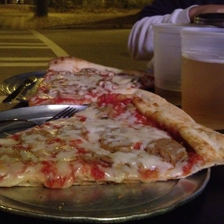

Model: n01496331  Predictions: electric_ray Confidence: 60.15%
Model: n01665541  Predictions: leatherback_turtle Confidence: 3.41%
Model: n01498041  Predictions: stingray Confidence: 2.55%
Model: n02066245  Predictions: grey_whale Confidence: 2.05%
Model: n02640242  Predictions: sturgeon Confidence: 1.23%


Image name: pizza\1044524.jpg


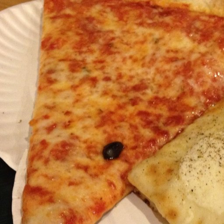

Model: n03041632  Predictions: cleaver Confidence: 5.98%
Model: n04270147  Predictions: spatula Confidence: 5.33%
Model: n02834397  Predictions: bib Confidence: 4.93%
Model: n07880968  Predictions: burrito Confidence: 4.27%
Model: n04525038  Predictions: velvet Confidence: 4.22%


Image name: pizza\1044789.jpg


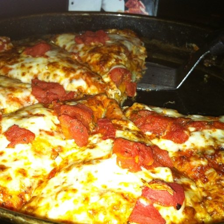

Model: n04033995  Predictions: quilt Confidence: 31.03%
Model: n04344873  Predictions: studio_couch Confidence: 11.25%
Model: n04235860  Predictions: sleeping_bag Confidence: 2.25%
Model: n04525038  Predictions: velvet Confidence: 2.20%
Model: n01665541  Predictions: leatherback_turtle Confidence: 1.56%


Image name: pizza\1048649.jpg


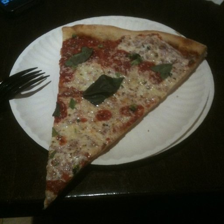

Model: n04192698  Predictions: shield Confidence: 14.52%
Model: n04033901  Predictions: quill Confidence: 10.29%
Model: n03929660  Predictions: pick Confidence: 7.00%
Model: n04591157  Predictions: Windsor_tie Confidence: 6.37%
Model: n03291819  Predictions: envelope Confidence: 4.65%


Image name: pizza\1054420.jpg


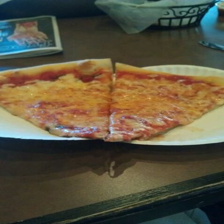

Model: n04344873  Predictions: studio_couch Confidence: 9.94%
Model: n04141327  Predictions: scabbard Confidence: 5.20%
Model: n02808440  Predictions: bathtub Confidence: 4.83%
Model: n03125729  Predictions: cradle Confidence: 3.92%
Model: n03658185  Predictions: letter_opener Confidence: 3.74%


Image name: pizza\1055065.jpg


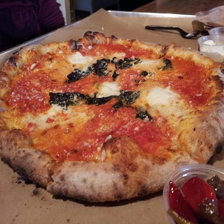

Model: n01496331  Predictions: electric_ray Confidence: 25.61%
Model: n03920288  Predictions: Petri_dish Confidence: 8.77%
Model: n01665541  Predictions: leatherback_turtle Confidence: 7.76%
Model: n07875152  Predictions: potpie Confidence: 5.66%
Model: n07873807  Predictions: pizza Confidence: 2.99%


Image name: not_pizza\1005746.jpg


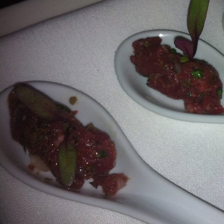

Model: n01496331  Predictions: electric_ray Confidence: 40.51%
Model: n04209133  Predictions: shower_cap Confidence: 19.03%
Model: n04447861  Predictions: toilet_seat Confidence: 5.74%
Model: n03775071  Predictions: mitten Confidence: 2.06%
Model: n02869837  Predictions: bonnet Confidence: 2.00%


Image name: not_pizza\1009225.jpg


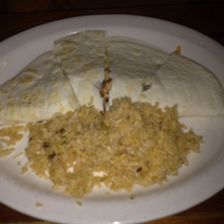

Model: n04447861  Predictions: toilet_seat Confidence: 49.92%
Model: n07873807  Predictions: pizza Confidence: 22.46%
Model: n04542943  Predictions: waffle_iron Confidence: 4.89%
Model: n07875152  Predictions: potpie Confidence: 2.67%
Model: n07613480  Predictions: trifle Confidence: 2.04%


Image name: not_pizza\1012312.jpg


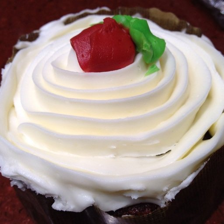

Model: n07860988  Predictions: dough Confidence: 45.41%
Model: n07875152  Predictions: potpie Confidence: 4.39%
Model: n04525038  Predictions: velvet Confidence: 1.86%
Model: n07684084  Predictions: French_loaf Confidence: 1.42%
Model: n01665541  Predictions: leatherback_turtle Confidence: 0.99%


Image name: not_pizza\1018802.jpg


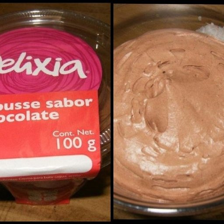

Model: n03920288  Predictions: Petri_dish Confidence: 32.18%
Model: n07932039  Predictions: eggnog Confidence: 18.39%
Model: n04447861  Predictions: toilet_seat Confidence: 9.77%
Model: n04258138  Predictions: solar_dish Confidence: 2.89%
Model: n07875152  Predictions: potpie Confidence: 2.03%


Image name: not_pizza\1020735.jpg


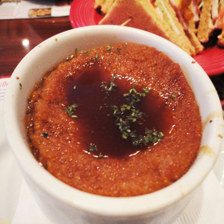

Model: n03929660  Predictions: pick Confidence: 45.67%
Model: n03476684  Predictions: hair_slide Confidence: 19.19%
Model: n02865351  Predictions: bolo_tie Confidence: 4.78%
Model: n04355933  Predictions: sunglass Confidence: 3.70%
Model: n07579787  Predictions: plate Confidence: 1.55%


Image name: not_pizza\1027142.jpg


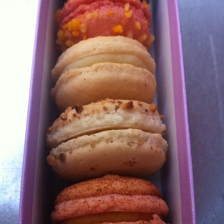

Model: n03314780  Predictions: face_powder Confidence: 61.08%
Model: n03920288  Predictions: Petri_dish Confidence: 5.46%
Model: n04286575  Predictions: spotlight Confidence: 3.15%
Model: n04447861  Predictions: toilet_seat Confidence: 2.12%
Model: n07875152  Predictions: potpie Confidence: 1.93%


Image name: not_pizza\102839.jpg


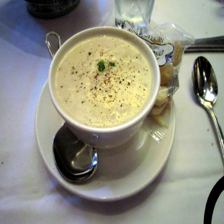

Model: n03920288  Predictions: Petri_dish Confidence: 26.18%
Model: n04447861  Predictions: toilet_seat Confidence: 7.83%
Model: n02808440  Predictions: bathtub Confidence: 4.32%
Model: n04493381  Predictions: tub Confidence: 3.93%
Model: n03400231  Predictions: frying_pan Confidence: 3.87%


Image name: not_pizza\1043233.jpg


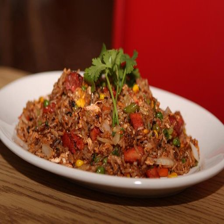

Model: n03447721  Predictions: gong Confidence: 54.12%
Model: n04447861  Predictions: toilet_seat Confidence: 15.52%
Model: n04209133  Predictions: shower_cap Confidence: 4.47%
Model: n04258138  Predictions: solar_dish Confidence: 2.54%
Model: n04553703  Predictions: washbasin Confidence: 1.06%


Image name: not_pizza\1045400.jpg


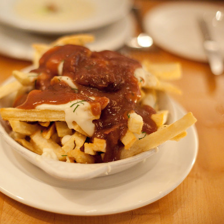

Model: n01753488  Predictions: horned_viper Confidence: 71.60%
Model: n01756291  Predictions: sidewinder Confidence: 3.57%
Model: n01742172  Predictions: boa_constrictor Confidence: 2.95%
Model: n01644900  Predictions: tailed_frog Confidence: 1.66%
Model: n07693725  Predictions: bagel Confidence: 1.20%


Image name: not_pizza\104773.jpg


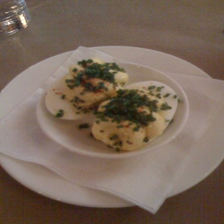

Model: n04525038  Predictions: velvet Confidence: 6.97%
Model: n02869837  Predictions: bonnet Confidence: 5.83%
Model: n04209133  Predictions: shower_cap Confidence: 5.52%
Model: n01496331  Predictions: electric_ray Confidence: 4.46%
Model: n07860988  Predictions: dough Confidence: 3.31%


Image name: not_pizza\1050956.jpg


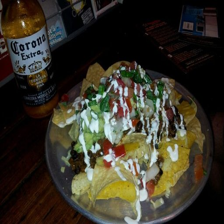

Model: n01496331  Predictions: electric_ray Confidence: 33.49%
Model: n01665541  Predictions: leatherback_turtle Confidence: 19.58%
Model: n01667778  Predictions: terrapin Confidence: 1.32%
Model: n01498041  Predictions: stingray Confidence: 1.30%
Model: n04033995  Predictions: quilt Confidence: 1.10%


Image name: not_pizza\1054362.jpg


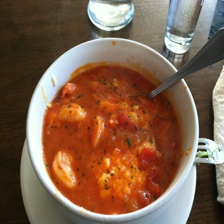

Model: n04325704  Predictions: stole Confidence: 45.04%
Model: n03207743  Predictions: dishrag Confidence: 27.77%
Model: n03980874  Predictions: poncho Confidence: 3.83%
Model: n02869837  Predictions: bonnet Confidence: 2.53%
Model: n02317335  Predictions: starfish Confidence: 1.52%


Image name: not_pizza\1062097.jpg


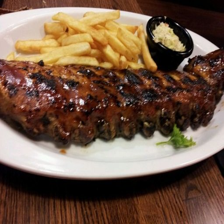

Model: n04542943  Predictions: waffle_iron Confidence: 38.14%
Model: n03400231  Predictions: frying_pan Confidence: 27.61%
Model: n04270147  Predictions: spatula Confidence: 4.20%
Model: n07875152  Predictions: potpie Confidence: 2.15%
Model: n07860988  Predictions: dough Confidence: 2.13%


Image name: not_pizza\1066151.jpg


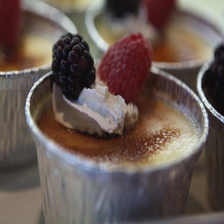

Model: n07579787  Predictions: plate Confidence: 59.54%
Model: n04447861  Predictions: toilet_seat Confidence: 3.79%
Model: n07584110  Predictions: consomme Confidence: 1.46%
Model: n07932039  Predictions: eggnog Confidence: 1.36%
Model: n03920288  Predictions: Petri_dish Confidence: 1.33%


Image name: not_pizza\1070772.jpg


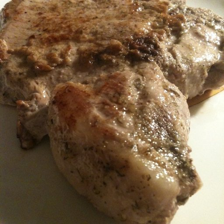

Model: n01496331  Predictions: electric_ray Confidence: 60.15%
Model: n01665541  Predictions: leatherback_turtle Confidence: 3.41%
Model: n01498041  Predictions: stingray Confidence: 2.55%
Model: n02066245  Predictions: grey_whale Confidence: 2.05%
Model: n02640242  Predictions: sturgeon Confidence: 1.23%


Image name: not_pizza\1070867.jpg


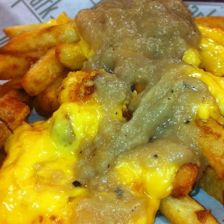

Model: n03041632  Predictions: cleaver Confidence: 5.98%
Model: n04270147  Predictions: spatula Confidence: 5.33%
Model: n02834397  Predictions: bib Confidence: 4.93%
Model: n07880968  Predictions: burrito Confidence: 4.27%
Model: n04525038  Predictions: velvet Confidence: 4.22%


Image name: not_pizza\107499.jpg


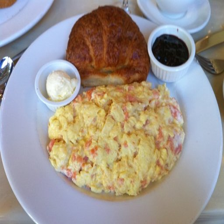

Model: n04033995  Predictions: quilt Confidence: 31.03%
Model: n04344873  Predictions: studio_couch Confidence: 11.25%
Model: n04235860  Predictions: sleeping_bag Confidence: 2.25%
Model: n04525038  Predictions: velvet Confidence: 2.20%
Model: n01665541  Predictions: leatherback_turtle Confidence: 1.56%


Image name: not_pizza\108055.jpg


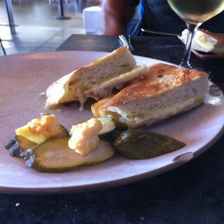

Model: n04192698  Predictions: shield Confidence: 14.52%
Model: n04033901  Predictions: quill Confidence: 10.29%
Model: n03929660  Predictions: pick Confidence: 7.00%
Model: n04591157  Predictions: Windsor_tie Confidence: 6.37%
Model: n03291819  Predictions: envelope Confidence: 4.65%


Image name: not_pizza\1081875.jpg


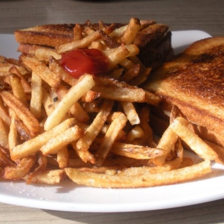

Model: n04344873  Predictions: studio_couch Confidence: 9.94%
Model: n04141327  Predictions: scabbard Confidence: 5.20%
Model: n02808440  Predictions: bathtub Confidence: 4.83%
Model: n03125729  Predictions: cradle Confidence: 3.92%
Model: n03658185  Predictions: letter_opener Confidence: 3.74%


Image name: not_pizza\1083749.jpg


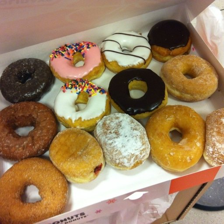

Model: n01496331  Predictions: electric_ray Confidence: 25.61%
Model: n03920288  Predictions: Petri_dish Confidence: 8.77%
Model: n01665541  Predictions: leatherback_turtle Confidence: 7.76%
Model: n07875152  Predictions: potpie Confidence: 5.66%
Model: n07873807  Predictions: pizza Confidence: 2.99%




In [23]:
# Printing classification results for EfficientNetV2
print_classification_results(pizza_images, pizza_image_paths, resultENV2, do_save=True, save_path='./results/efficientnetv2/pizza')
print_classification_results(not_pizza_images, not_pizza_image_paths, resultENV2, do_save=True, save_path='./results/efficientnetv2/not_pizza')

**<h3>Evaluating the results of the different models</h3>**

**<h4>Function which labels the predictions based on the target label</h4>**

In [24]:
def score(results, target_label):
    """Function which labels the predictions based on the target label

    Args:
        results (list): list of predictions.
        target_label (str): target label.
    
    Returns:
        pred_labels (list): list of predicted labels
    """
    # Declaring necessary variables
    pred_labels = []

    # Iterating through all images in the given dictionary
    for i, prediction in enumerate(results):
        if prediction[0][1] == target_label:
            pred_labels.append(1)
        else:
            pred_labels.append(0)

    # Returning predicted labels
    return pred_labels

**<h4>Function which calculates accuracy, precision, recall and F1 score</h4>**

In [25]:
def calculate_metrics(TP, TN, FP, FN):
    """Function which calculates accuracy, precision, recall and F1 score

    Args:
        TP (int): true positives.
        TN (int): true negatives.
        FP (int): false positives.
        FN (int): false negatives.
    
    Returns:
        accuracy (float): accuracy
        precision (float): precision
        recall (float): recall
        f1_score (float): F1 score
    """    
    # Calculating accuracy
    accuracy = float(TP + TN) / float(TP + TN + FP + FN) if (TP + TN + FP + FN) != 0 else 0.0

    # Calculating precision
    precision = float(TP) / float(TP + FP) if (TP + FP) != 0 else 0.0

    # Calculating recall
    recall = float(TP) / float(TP + FN) if (TP + FN) != 0 else 0.0

    # Calculating F1 score
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) != 0 else 0.0

    # Returning metrics
    return accuracy, precision, recall, f1_score

**<h4>Function which calculates model metrics for the given predictions</h4>**

In [26]:
def calculate_model_metrics(results, target_label, true_labels=None):
    """Function which calculates model metrics for the given predictions

    Args:
        results (dict): dictionary with predictions.
        target_label (str): target label.
        true_labels (list): list of true labels. Defaults to None.

    Returns:
        accuracy (float): accuracy
        precision (float): precision
        recall (float): recall
        f1_score (float): F1 score
        confusion_matrix (list): confusion matrix
    """
    # Setting true labels to all ones if not provided
    if true_labels is None:
        true_labels = np.ones(len(results))

    # Generating predicted labels
    pred_labels = np.array(score(results, target_label))

    # Calculating true positives, true negatives, false positives and false negatives
    true_positives = np.sum(np.logical_and(pred_labels == 1, true_labels == 1))
    true_negatives = np.sum(np.logical_and(pred_labels == 0, true_labels == 0))
    false_positives = np.sum(np.logical_and(pred_labels == 1, true_labels == 0))
    false_negatives = np.sum(np.logical_and(pred_labels == 0, true_labels == 1))
    
    # Calculating accuracy, precision, recall and F1 score
    accuracy, precision, recall, f1_score = calculate_metrics(true_positives, true_negatives, false_positives, false_negatives)

    # Calculating confusion matrix
    confusion_matrix = [[true_positives, false_positives], [false_negatives, true_negatives]]

    # Returning accuracy, precision, recall, f1_score and confusion_matrix
    return accuracy, precision, recall, f1_score, confusion_matrix

**<h4>Function which prints confusion matrix</h4>**

In [27]:
def print_confusion_matrix(title, confusion_matrix, do_save=False, save_path=None):
    """Function which prints confusion matrix

    Args:
        title (str): title of the confusion matrix.
        confusion_matrix (list): confusion matrix.
        do_save (bool): flag to save confusion matrix. Defaults to False.
        save_path (str): path to save confusion matrix. Defaults to None.
    """
    # Declaring necessary variables
    df_cm = pd.DataFrame(confusion_matrix, index = [i for i in ['Actual Positive', 'Actual Negative']],
                  columns = [i for i in ['Predicted Positive', 'Predicted Negative']])
    
    # Displaying confusion matrix
    plt.figure(figsize = (10,7))
    plt.title(title)
    sn.heatmap(df_cm, annot=True, cmap='Blues', fmt='g')

    # Saving confusion matrix if do_save is True
    if do_save:
        # Creating path if it does not exist
        if not os.path.exists(save_path):
            os.makedirs(save_path)

        # Saving confusion matrix
        plt.savefig(os.path.join(save_path, title + '.png'))

    # Displaying confusion matrix
    plt.show()

**<h4>Function which plots metric results for different models as a bar graph</h4>**

In [28]:
def plot_model_comparisons(results, do_save=False, save_path=None):
    """Function which plots metric results for different models as a bar graph

    Args:
        results (dict): dictionary of metrics for different models.
        do_save (bool): flag to save plot. Defaults to False.
        save_path (str): path to save plot. Defaults to None.
    """
    # Extracting model names and metrics
    model_names = list(results.keys())
    metrics = list(results.values())

    # Extracting individual metric values for each model
    accuracy = [metric[0] for metric in metrics]
    precision = [metric[1] for metric in metrics]
    recall = [metric[2] for metric in metrics]
    f1_score = [metric[3] for metric in metrics]

    # Setting up bar positions
    bar_width = 0.2
    index = np.arange(len(model_names))

    # Plotting results as a bar graph
    plt.figure(figsize=(12, 7))
    plt.bar(index, accuracy, width=bar_width, label='Accuracy', color='red')
    plt.bar(index + bar_width, precision, width=bar_width, label='Precision', color='green')
    plt.bar(index + 2 * bar_width, recall, width=bar_width, label='Recall', color='blue')
    plt.bar(index + 3 * bar_width, f1_score, width=bar_width, label='F1 Score', color='orange')
    
    # Annotating each bar with its corresponding metric value
    for i, model in enumerate(model_names):
        plt.text(index[i] - 0.1, accuracy[i] + 0.01, f'{accuracy[i]:.2f}', color='black', fontsize=10)
        plt.text(index[i] + bar_width - 0.1, precision[i] + 0.01, f'{precision[i]:.2f}', color='black', fontsize=10)
        plt.text(index[i] + 2 * bar_width - 0.1, recall[i] + 0.01, f'{recall[i]:.2f}', color='black', fontsize=10)
        plt.text(index[i] + 3 * bar_width - 0.1, f1_score[i] + 0.01, f'{f1_score[i]:.2f}', color='black', fontsize=10)

    # Plotting labels and legends
    plt.xlabel('Models', fontsize=14)
    plt.ylabel('Metrics', fontsize=14)
    plt.title('Comparison of different Object Classification Models', fontsize=16)
    plt.xticks(index + 1.5 * bar_width, model_names)
    plt.tight_layout()
    plt.legend()
    plt.grid(alpha=0.3)

    # Saving plot if do_save is True
    if do_save:
        # Creating path if it does not exist
        if not os.path.exists(save_path):
            os.makedirs(save_path)

        # Saving plot
        plt.savefig(os.path.join(save_path, 'model_comparisons.png'))

    # Displaying plot
    plt.show()

Model: ResNet50  Accuracy: 90.00% Precision: 100.00%  Recall: 80.00%  F1 Score: 88.89%


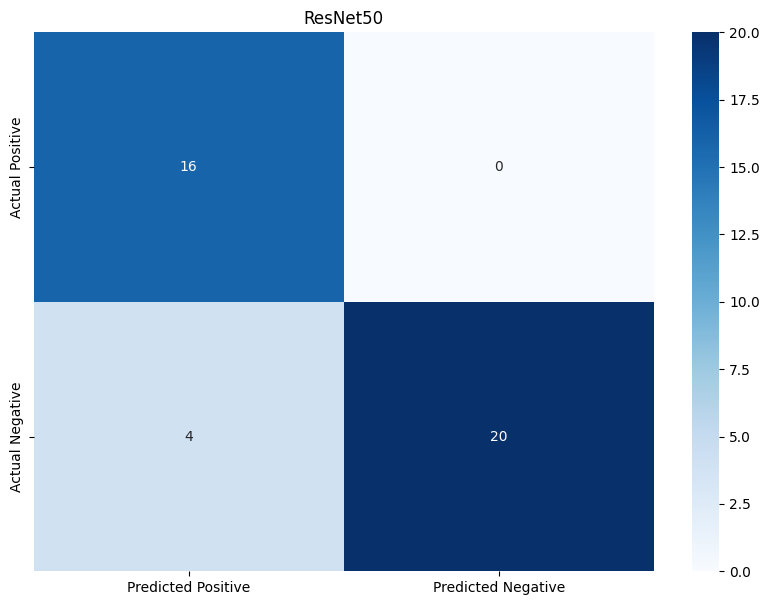

Model: VGG16  Accuracy: 87.50% Precision: 100.00%  Recall: 75.00%  F1 Score: 85.71%


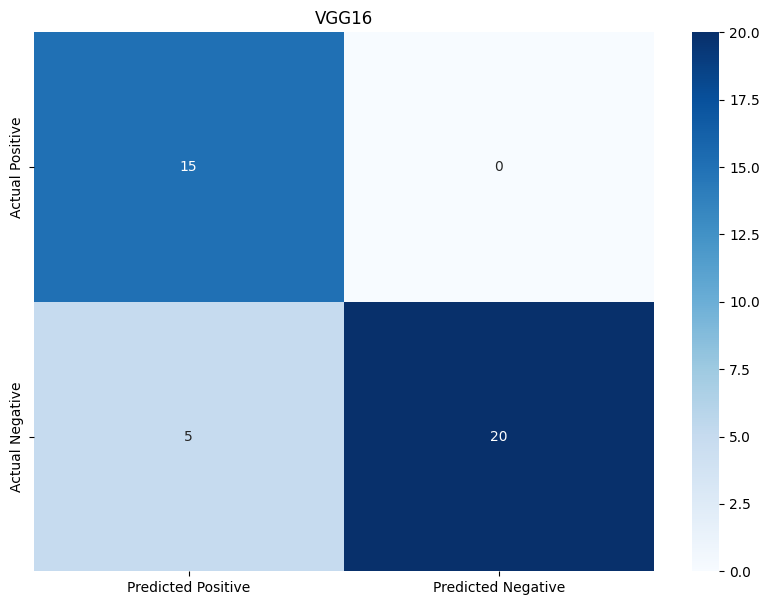

Model: MobileNet  Accuracy: 50.00% Precision: 0.00%  Recall: 0.00%  F1 Score: 0.00%


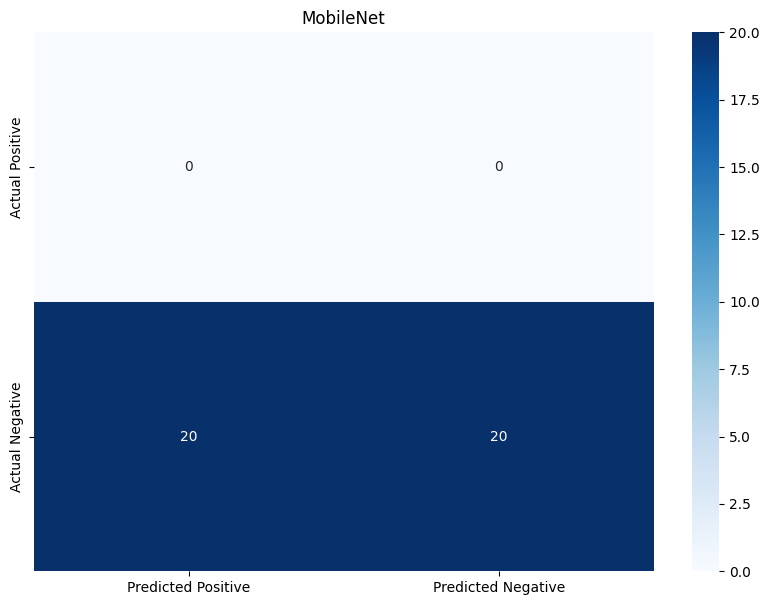

Model: InceptionResNetV2  Accuracy: 50.00% Precision: 0.00%  Recall: 0.00%  F1 Score: 0.00%


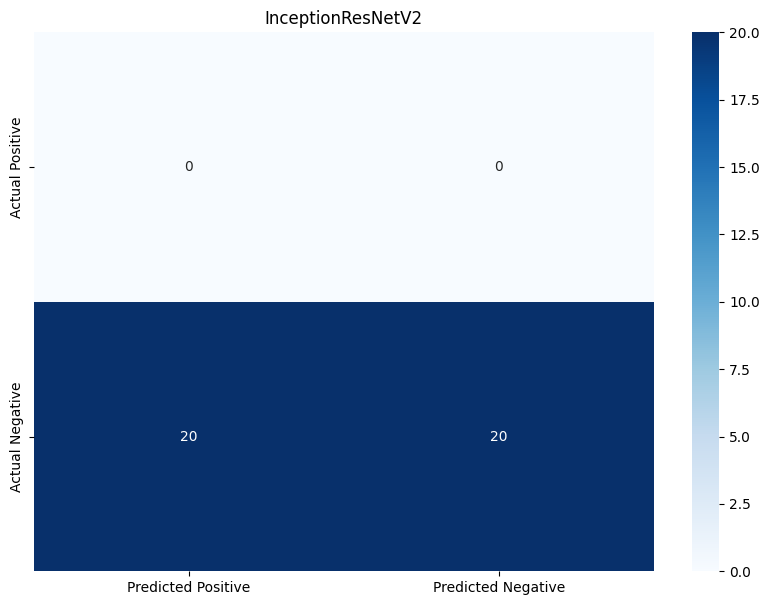

Model: EfficientNetV2  Accuracy: 50.00% Precision: 0.00%  Recall: 0.00%  F1 Score: 0.00%


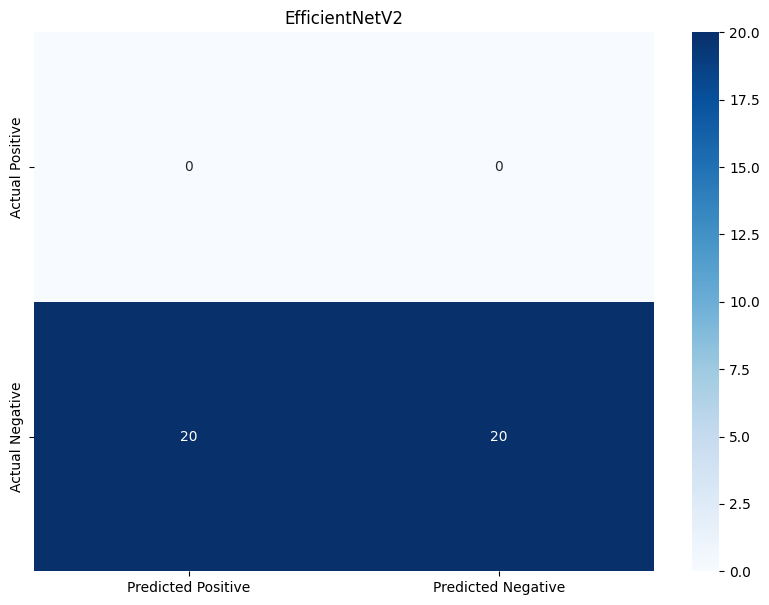

In [29]:
# Calculating the true labels
true_labels = np.concatenate((np.ones(no_of_pizza_images), np.zeros(no_of_not_pizza_images)))

# Calculating accuracy and confusion matrix for the different models
results ={"ResNet50": calculate_model_metrics(resultRN50, 'pizza', true_labels),
            "VGG16": calculate_model_metrics(resultV16, 'pizza', true_labels),
            "MobileNet": calculate_model_metrics(resultMN, 'pizza', true_labels),
            "InceptionResNetV2": calculate_model_metrics(resultIRN, 'pizza', true_labels),
            "EfficientNetV2": calculate_model_metrics(resultENV2, 'pizza', true_labels)}

# Printing accuracy for the different models
for model, result in results.items():
    print('\033[1m' + 'Model: {}  Accuracy: {:.2%} Precision: {:.2%}  Recall: {:.2%}  F1 Score: {:.2%}' \
              .format(model, result[0], result[1], result[2], result[3]) + '\033[0m')
    print_confusion_matrix(model, result[4], do_save=True, save_path='results/confusion_matrix')


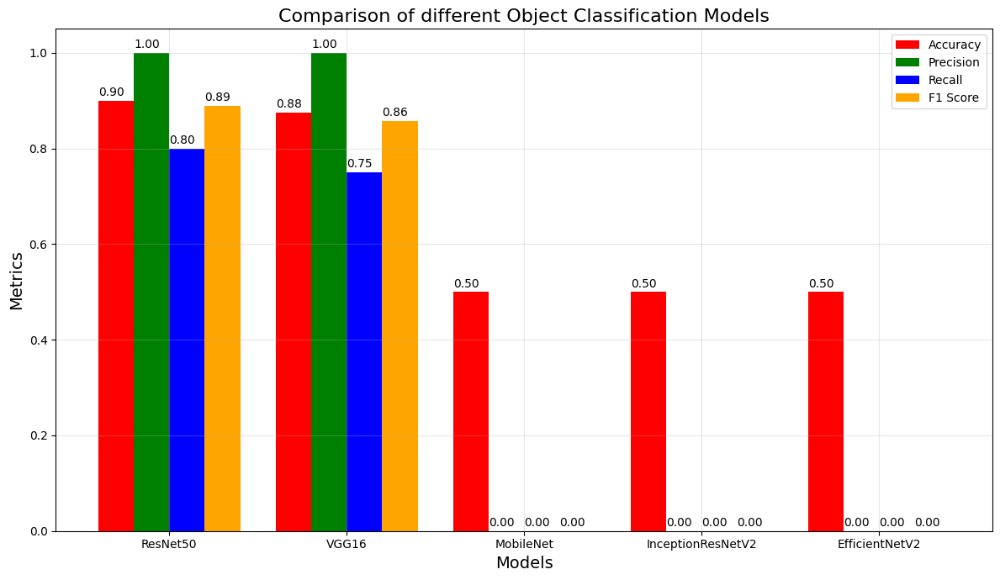

In [30]:
# Plotting model comparisons
plot_model_comparisons(results, do_save=True, save_path='results')